In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import xgboost as xgb

from sklearn.linear_model import SGDRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import RandomizedSearchCV
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Activation,Flatten
from tensorflow.keras.layers import Dropout
from tensorflow.keras.losses import MSE, MAE
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import train_test_split
from scipy import stats
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error,make_scorer
from scipy.sparse import hstack
from google.colab import drive

drive.mount('/content/drive')

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


**DATA Loading**

In [2]:
train_data = pd.read_csv('/content/drive/My Drive/Colab Notebooks/train.csv')
test_data = pd.read_csv('/content/drive/My Drive/Colab Notebooks/test.csv')

print('Trainig data --',train_data.shape,'------Testing_data--',test_data.shape)
train_data.head()

Trainig data -- (188318, 132) ------Testing_data-- (125546, 131)


,id,cat1,cat2,cat3,cat4,cat5,cat6,cat7,cat8,cat9,cat10,cat11,cat12,cat13,cat14,cat15,cat16,cat17,cat18,cat19,cat20,cat21,cat22,cat23,cat24,cat25,cat26,cat27,cat28,cat29,cat30,cat31,cat32,cat33,cat34,cat35,cat36,cat37,cat38,cat39,...,cat92,cat93,cat94,cat95,cat96,cat97,cat98,cat99,cat100,cat101,cat102,cat103,cat104,cat105,cat106,cat107,cat108,cat109,cat110,cat111,cat112,cat113,cat114,cat115,cat116,cont1,cont2,cont3,cont4,cont5,cont6,cont7,cont8,cont9,cont10,cont11,cont12,cont13,cont14,loss
0,1,A,B,A,B,A,A,A,A,B,A,B,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,...,A,D,B,C,E,A,C,T,B,G,A,A,I,E,G,J,G,BU,BC,C,AS,S,A,O,LB,0.726300,0.245921,0.187583,0.789639,0.310061,0.718367,0.335060,0.30260,0.67135,0.83510,0.569745,0.594646,0.822493,0.714843,2213.18
1,2,A,B,A,A,A,A,A,A,B,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,...,A,D,D,C,E,E,D,T,L,F,A,A,E,E,I,K,K,BI,CQ,A,AV,BM,A,O,DP,0.330514,0.737068,0.592681,0.614134,0.885834,0.438917,0.436585,0.60087,0.35127,0.43919,0.338312,0.366307,0.611431,0.304496,1283.60
2,5,A,B,A,A,B,A,A,A,B,B,B,B,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,...,A,D,D,C,E,E,A,D,L,O,A,B,E,F,H,F,A,AB,DK,A,C,AF,A,I,GK,0.261841,0.358319,0.484196,0.236924,0.397069,0.289648,0.315545,0.27320,0.26076,0.32446,0.381398,0.373424,0.195709,0.774425,3005.09
3,10,B,B,A,B,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,...,A,D,D,C,E,E,D,T,I,D,A,A,E,E,I,K,K,BI,CS,C,N,AE,A,O,DJ,0.321594,0.555782,0.527991,0.373816,0.422268,0.440945,0.391128,0.31796,0.32128,0.44467,0.327915,0.321570,0.605077,0.602642,939.85
4,11,A,B,A,B,A,A,A,A,B,B,A,B,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,...,H,D,B,D,E,E,A,P,F,J,A,A,D,E,K,G,B,H,C,C,Y,BM,A,K,CK,0.273204,0.159990,0.527991,0.473202,0.704268,0.178193,0.247408,0.24564,0.22089,0.21230,0.204687,0.202213,0.246011,0.432606,2763.85


Load the train and test data from the csv file into pandas dataframe. Review shape of dataset and all features. From this review we conclude 116 categorical features and 15 continuous features.


**Remove unnecessary columns**

In [3]:
train_data = train_data.drop(columns=['id'],axis='column')
test_data = test_data.drop(columns=['id'],axis='column')

print('Trainig data --',train_data.shape,'------Testing_data--',test_data.shape)
train_data.head()

Trainig data -- (188318, 131) ------Testing_data-- (125546, 130)


,cat1,cat2,cat3,cat4,cat5,cat6,cat7,cat8,cat9,cat10,cat11,cat12,cat13,cat14,cat15,cat16,cat17,cat18,cat19,cat20,cat21,cat22,cat23,cat24,cat25,cat26,cat27,cat28,cat29,cat30,cat31,cat32,cat33,cat34,cat35,cat36,cat37,cat38,cat39,cat40,...,cat92,cat93,cat94,cat95,cat96,cat97,cat98,cat99,cat100,cat101,cat102,cat103,cat104,cat105,cat106,cat107,cat108,cat109,cat110,cat111,cat112,cat113,cat114,cat115,cat116,cont1,cont2,cont3,cont4,cont5,cont6,cont7,cont8,cont9,cont10,cont11,cont12,cont13,cont14,loss
0,A,B,A,B,A,A,A,A,B,A,B,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,...,A,D,B,C,E,A,C,T,B,G,A,A,I,E,G,J,G,BU,BC,C,AS,S,A,O,LB,0.726300,0.245921,0.187583,0.789639,0.310061,0.718367,0.335060,0.30260,0.67135,0.83510,0.569745,0.594646,0.822493,0.714843,2213.18
1,A,B,A,A,A,A,A,A,B,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,...,A,D,D,C,E,E,D,T,L,F,A,A,E,E,I,K,K,BI,CQ,A,AV,BM,A,O,DP,0.330514,0.737068,0.592681,0.614134,0.885834,0.438917,0.436585,0.60087,0.35127,0.43919,0.338312,0.366307,0.611431,0.304496,1283.60
2,A,B,A,A,B,A,A,A,B,B,B,B,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,...,A,D,D,C,E,E,A,D,L,O,A,B,E,F,H,F,A,AB,DK,A,C,AF,A,I,GK,0.261841,0.358319,0.484196,0.236924,0.397069,0.289648,0.315545,0.27320,0.26076,0.32446,0.381398,0.373424,0.195709,0.774425,3005.09
3,B,B,A,B,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,...,A,D,D,C,E,E,D,T,I,D,A,A,E,E,I,K,K,BI,CS,C,N,AE,A,O,DJ,0.321594,0.555782,0.527991,0.373816,0.422268,0.440945,0.391128,0.31796,0.32128,0.44467,0.327915,0.321570,0.605077,0.602642,939.85
4,A,B,A,B,A,A,A,A,B,B,A,B,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,...,H,D,B,D,E,E,A,P,F,J,A,A,D,E,K,G,B,H,C,C,Y,BM,A,K,CK,0.273204,0.159990,0.527991,0.473202,0.704268,0.178193,0.247408,0.24564,0.22089,0.21230,0.204687,0.202213,0.246011,0.432606,2763.85


Removed unnecessary{ID] columns Its like index attribute to uniquely identify each claim row.


**Split Numerical and Categorical features**

In [4]:
cat_features = []
num_features = []

for feature in train_data.columns:
  if 'cat' in feature:
    cat_features.append(feature)
  else:
    num_features.append(feature)
  
print('No of categorical features --',len(cat_features),'--Numerical features --',len(num_features))

No of categorical features -- 116 --Numerical features -- 15


**Categorical features analysis**

In [ ]:
#missing values column wise
list_of_cols_without_missing_recs = list(train_data[cat_features].isnull().sum()).count(0)
if list_of_cols_without_missing_recs==len(cat_features):
  print('No missing values in train dataset')

#data either in train or train, not in both 
cols_differ_by_data = []
for column in cat_features:
  train = sorted(train_data[column].unique())
  test = sorted(test_data[column].unique())
  if len([val for val in test if val not in train])!=0:
    cols_differ_by_data.append(column)

print('Categorical features which are having different data in both datsets----',cols_differ_by_data)

No missing values in train dataset
Categorical features which are having different data in both datsets---- ['cat89', 'cat92', 'cat96', 'cat99', 'cat103', 'cat106', 'cat109', 'cat110', 'cat111', 'cat113', 'cat116']


**Count plot and frequency**

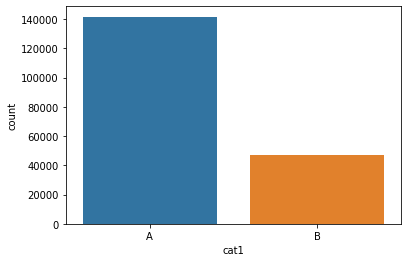

Frequency ---- A    75.165412
B    24.834588
Name: cat1, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


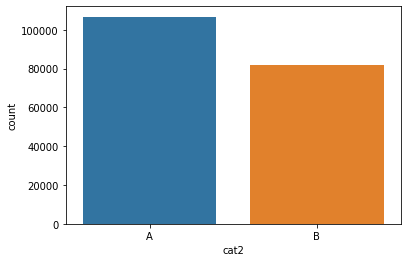

Frequency ---- A    56.670632
B    43.329368
Name: cat2, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


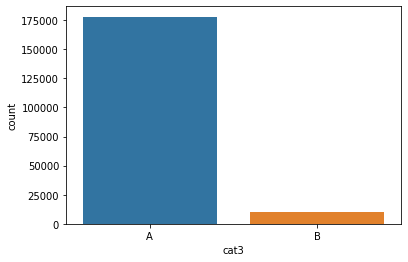

Frequency ---- A    94.517253
B     5.482747
Name: cat3, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


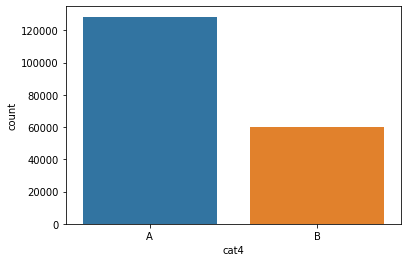

Frequency ---- A    68.179887
B    31.820113
Name: cat4, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


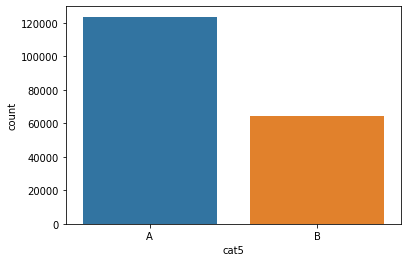

Frequency ---- A    65.706411
B    34.293589
Name: cat5, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


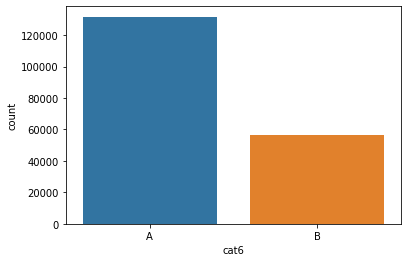

Frequency ---- A    69.93118
B    30.06882
Name: cat6, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


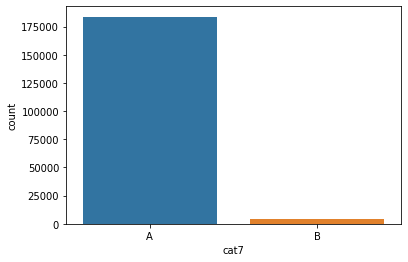

Frequency ---- A    97.57113
B     2.42887
Name: cat7, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


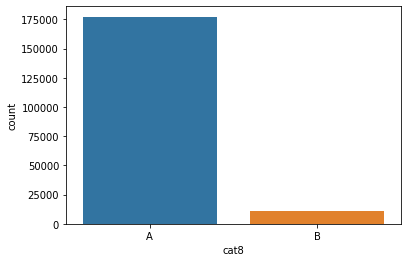

Frequency ---- A    94.135452
B     5.864548
Name: cat8, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


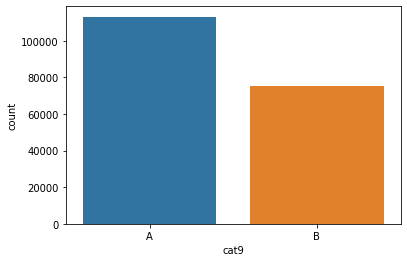

Frequency ---- A    60.069669
B    39.930331
Name: cat9, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


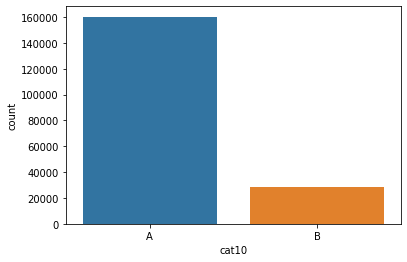

Frequency ---- A    85.075776
B    14.924224
Name: cat10, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


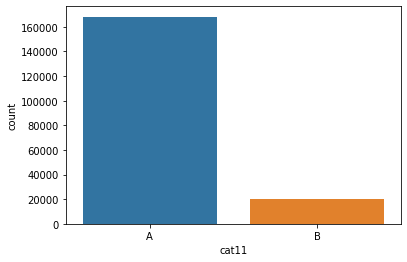

Frequency ---- A    89.309572
B    10.690428
Name: cat11, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


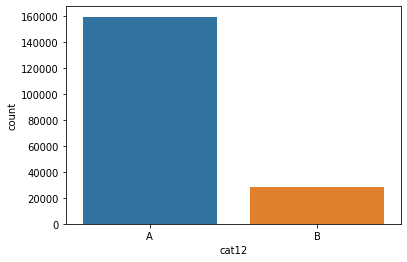

Frequency ---- A    84.869742
B    15.130258
Name: cat12, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


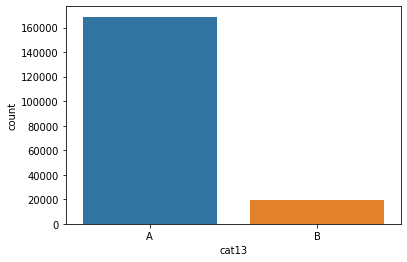

Frequency ---- A    89.662698
B    10.337302
Name: cat13, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


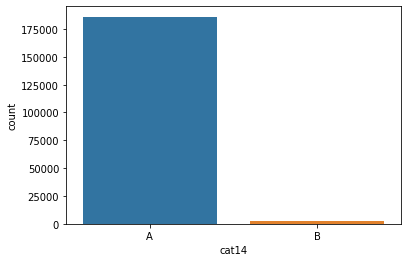

Frequency ---- A    98.790875
B     1.209125
Name: cat14, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


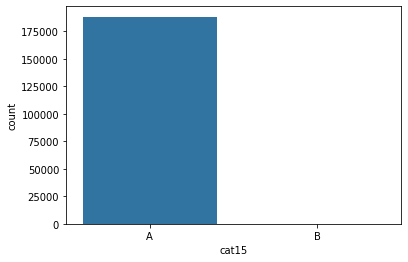

Frequency ---- A    99.981945
B     0.018055
Name: cat15, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


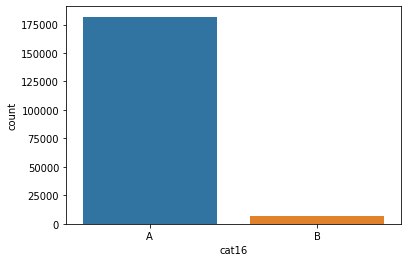

Frequency ---- A    96.561667
B     3.438333
Name: cat16, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


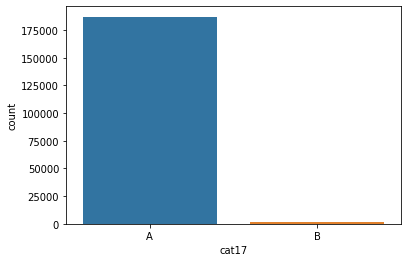

Frequency ---- A    99.304899
B     0.695101
Name: cat17, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


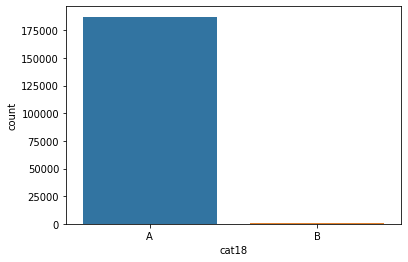

Frequency ---- A    99.475887
B     0.524113
Name: cat18, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


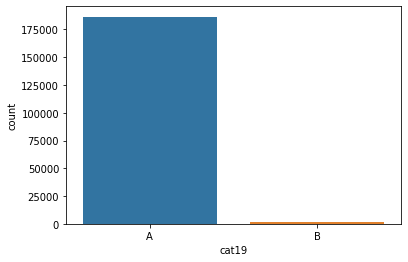

Frequency ---- A    99.039922
B     0.960078
Name: cat19, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


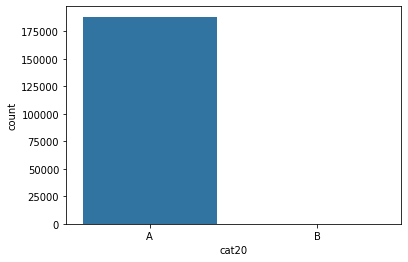

Frequency ---- A    99.891673
B     0.108327
Name: cat20, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


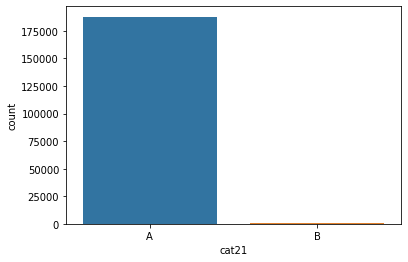

Frequency ---- A    99.78069
B     0.21931
Name: cat21, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


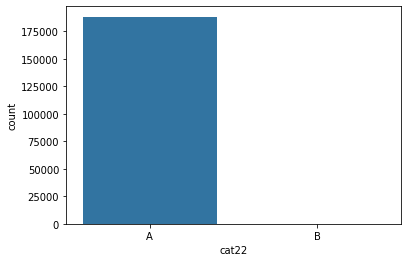

Frequency ---- A    99.977166
B     0.022834
Name: cat22, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


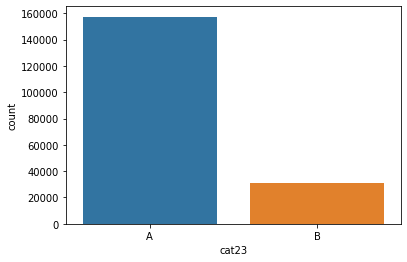

Frequency ---- A    83.605922
B    16.394078
Name: cat23, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


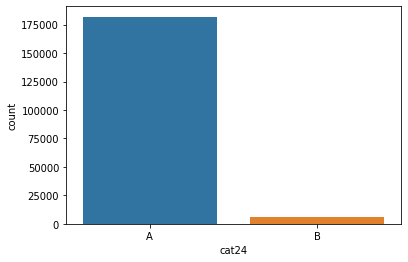

Frequency ---- A    96.632823
B     3.367177
Name: cat24, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


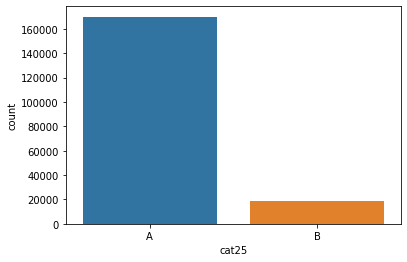

Frequency ---- A    90.256375
B     9.743625
Name: cat25, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


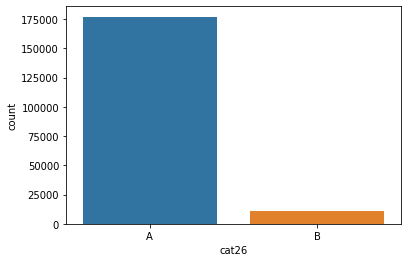

Frequency ---- A    94.053144
B     5.946856
Name: cat26, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


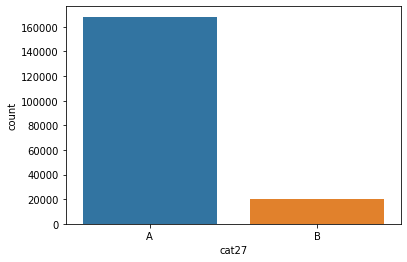

Frequency ---- A    89.343557
B    10.656443
Name: cat27, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


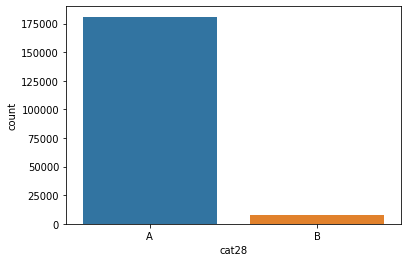

Frequency ---- A    96.081097
B     3.918903
Name: cat28, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


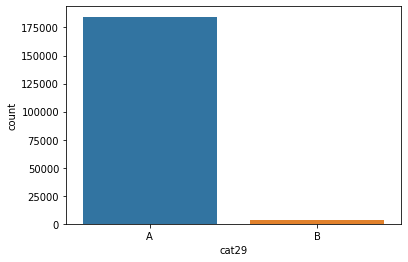

Frequency ---- A    98.021963
B     1.978037
Name: cat29, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


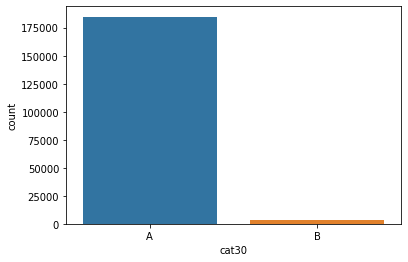

Frequency ---- A    98.110643
B     1.889357
Name: cat30, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


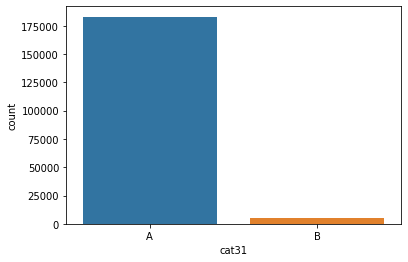

Frequency ---- A    97.165433
B     2.834567
Name: cat31, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


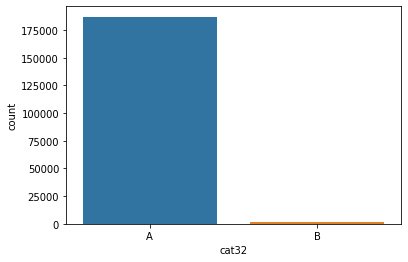

Frequency ---- A    99.356939
B     0.643061
Name: cat32, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


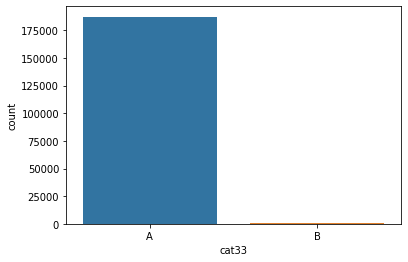

Frequency ---- A    99.491817
B     0.508183
Name: cat33, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


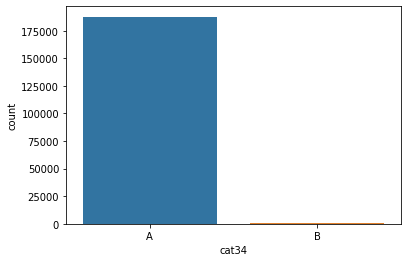

Frequency ---- A    99.689886
B     0.310114
Name: cat34, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


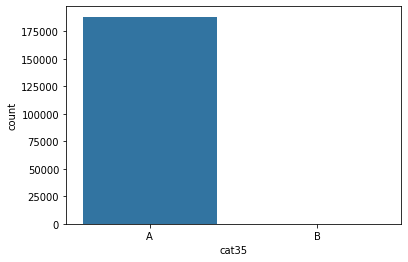

Frequency ---- A    99.886893
B     0.113107
Name: cat35, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


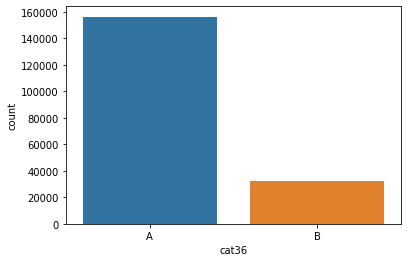

Frequency ---- A    83.004811
B    16.995189
Name: cat36, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


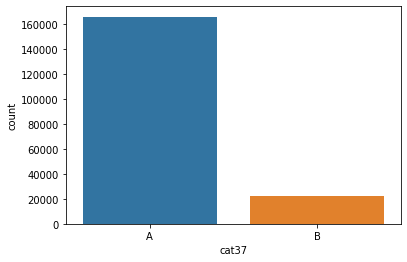

Frequency ---- A    88.004864
B    11.995136
Name: cat37, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


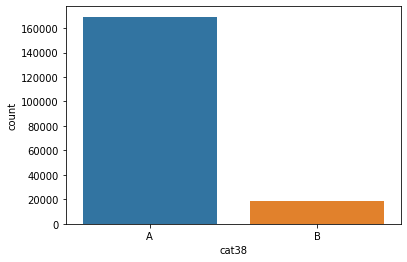

Frequency ---- A    89.913338
B    10.086662
Name: cat38, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


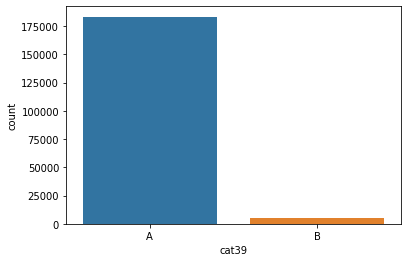

Frequency ---- A    97.384743
B     2.615257
Name: cat39, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


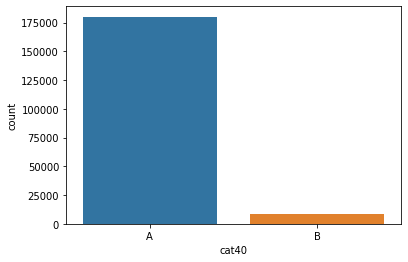

Frequency ---- A    95.646194
B     4.353806
Name: cat40, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


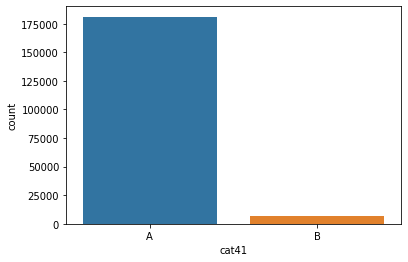

Frequency ---- A    96.20801
B     3.79199
Name: cat41, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


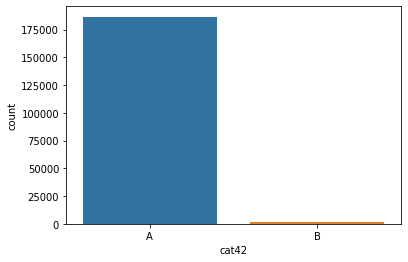

Frequency ---- A    99.099927
B     0.900073
Name: cat42, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


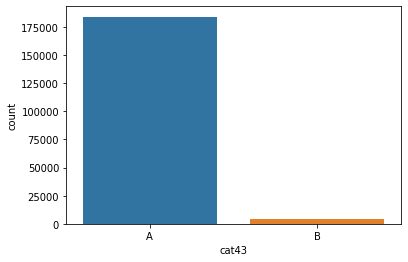

Frequency ---- A    97.765482
B     2.234518
Name: cat43, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


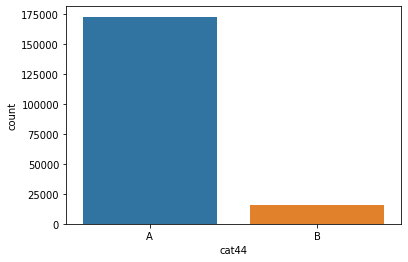

Frequency ---- A    91.715078
B     8.284922
Name: cat44, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


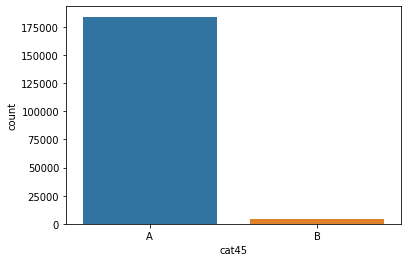

Frequency ---- A    97.702291
B     2.297709
Name: cat45, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


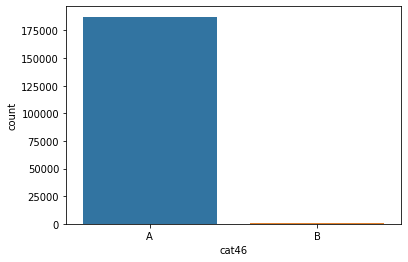

Frequency ---- A    99.531643
B     0.468357
Name: cat46, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


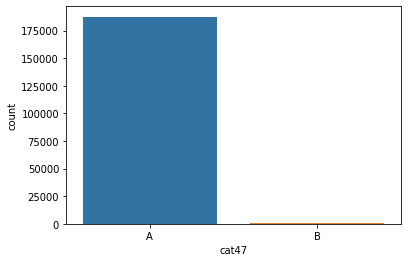

Frequency ---- A    99.627757
B     0.372243
Name: cat47, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


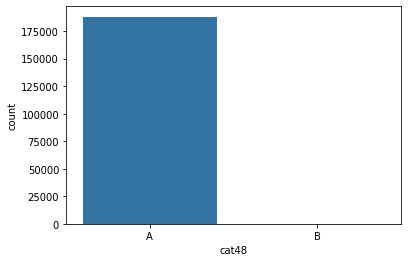

Frequency ---- A    99.857157
B     0.142843
Name: cat48, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


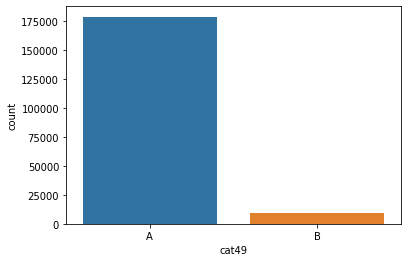

Frequency ---- A    95.119426
B     4.880574
Name: cat49, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


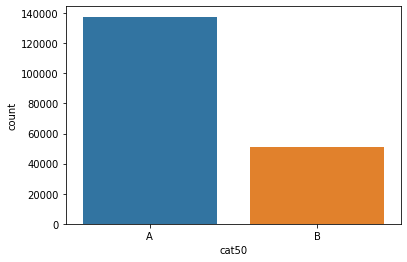

Frequency ---- A    73.073737
B    26.926263
Name: cat50, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


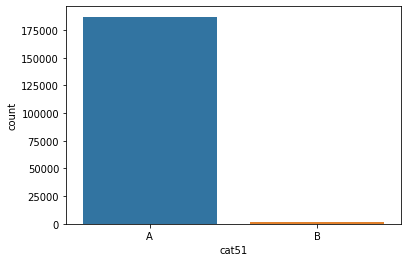

Frequency ---- A    99.337822
B     0.662178
Name: cat51, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


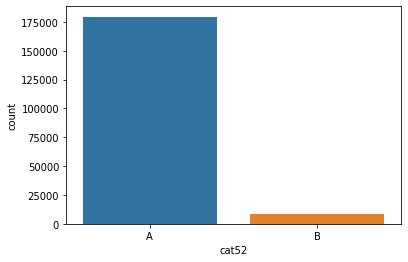

Frequency ---- A    95.32015
B     4.67985
Name: cat52, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


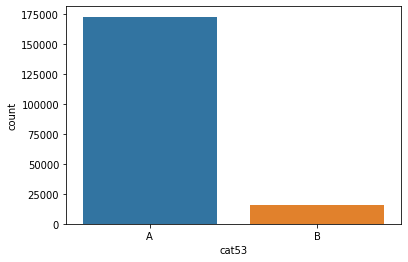

Frequency ---- A    91.838805
B     8.161195
Name: cat53, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


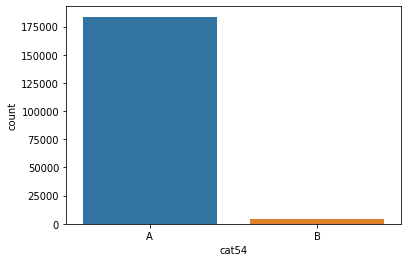

Frequency ---- A    97.580688
B     2.419312
Name: cat54, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


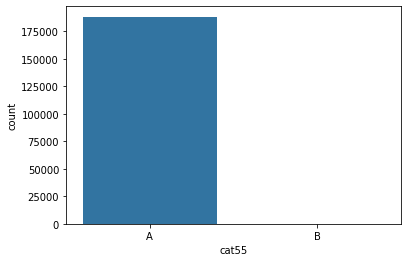

Frequency ---- A    99.923003
B     0.076997
Name: cat55, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


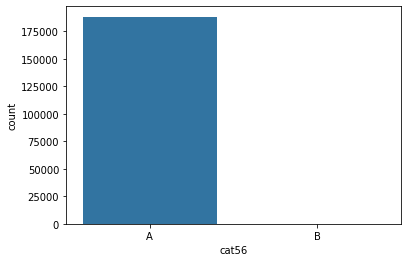

Frequency ---- A    99.903355
B     0.096645
Name: cat56, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


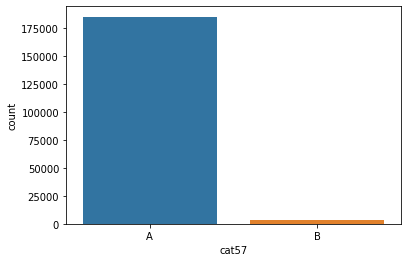

Frequency ---- A    98.395268
B     1.604732
Name: cat57, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


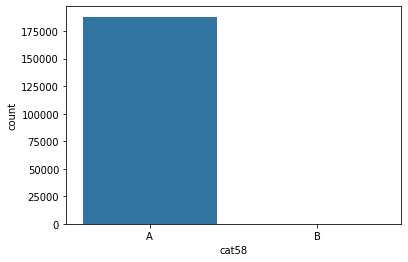

Frequency ---- A    99.873087
B     0.126913
Name: cat58, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


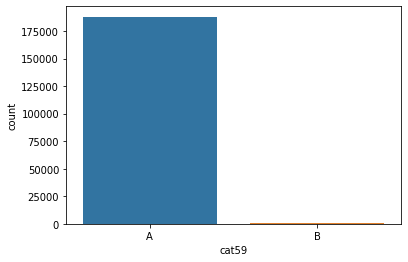

Frequency ---- A    99.840695
B     0.159305
Name: cat59, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


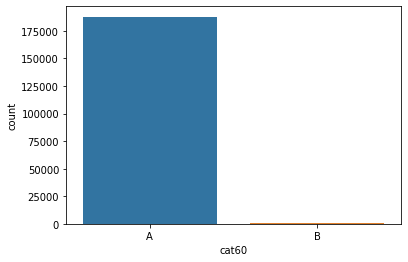

Frequency ---- A    99.763167
B     0.236833
Name: cat60, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


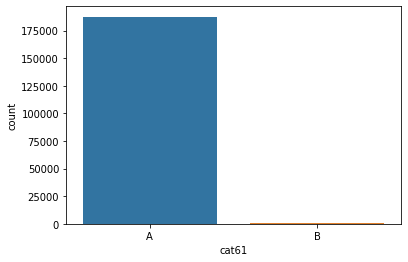

Frequency ---- A    99.616606
B     0.383394
Name: cat61, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


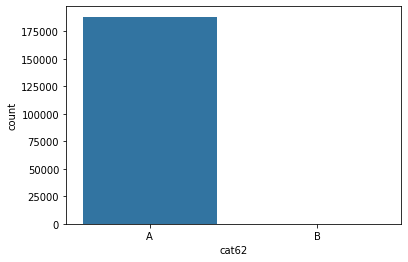

Frequency ---- A    99.976104
B     0.023896
Name: cat62, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


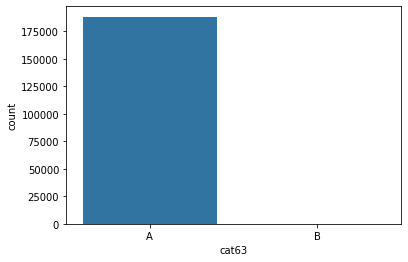

Frequency ---- A    99.95805
B     0.04195
Name: cat63, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


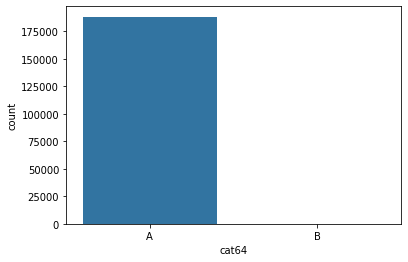

Frequency ---- A    99.975042
B     0.024958
Name: cat64, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


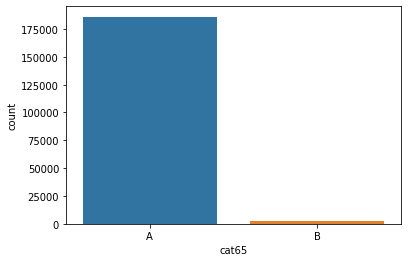

Frequency ---- A    98.79884
B     1.20116
Name: cat65, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


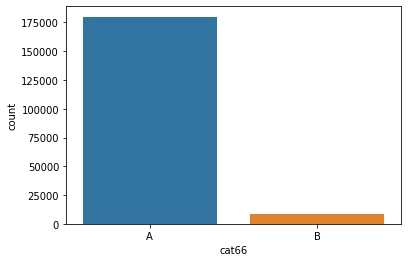

Frequency ---- A    95.573445
B     4.426555
Name: cat66, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


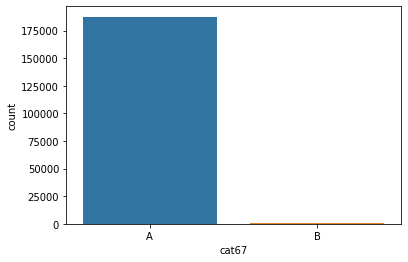

Frequency ---- A    99.632536
B     0.367464
Name: cat67, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


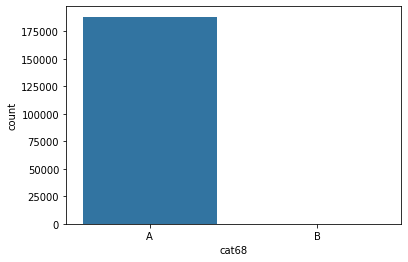

Frequency ---- A    99.924596
B     0.075404
Name: cat68, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


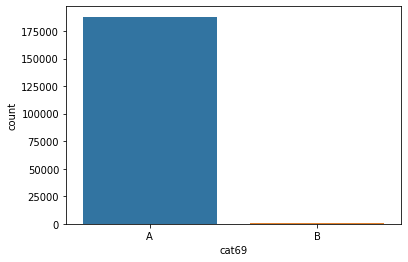

Frequency ---- A    99.836978
B     0.163022
Name: cat69, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


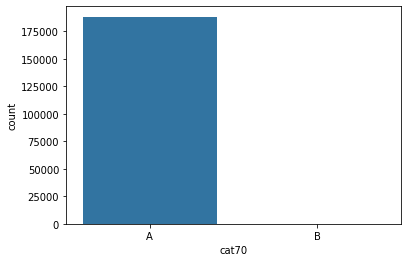

Frequency ---- A    99.987787
B     0.012213
Name: cat70, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


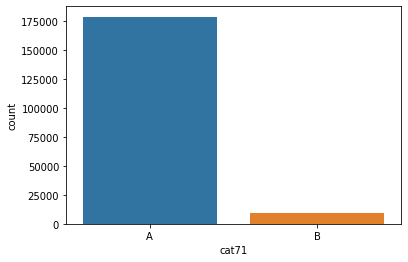

Frequency ---- A    94.864007
B     5.135993
Name: cat71, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


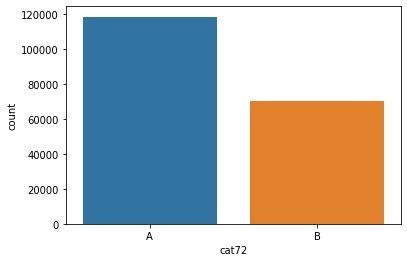

Frequency ---- A    62.830956
B    37.169044
Name: cat72, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


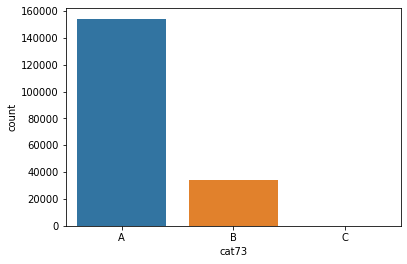

Frequency ---- A    81.922599
B    18.063595
C     0.013806
Name: cat73, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


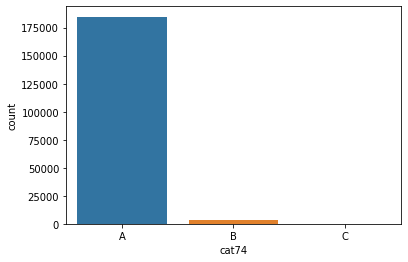

Frequency ---- A    98.095243
B     1.890950
C     0.013806
Name: cat74, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


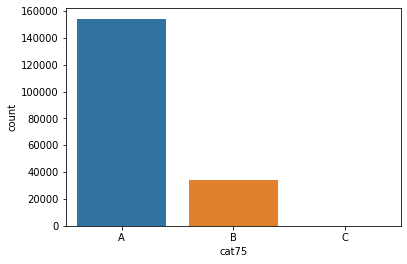

Frequency ---- A    81.939592
B    18.059877
C     0.000531
Name: cat75, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


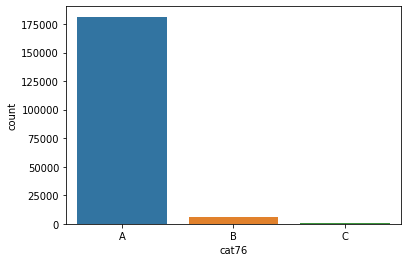

Frequency ---- A    96.298283
B     3.283276
C     0.418441
Name: cat76, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


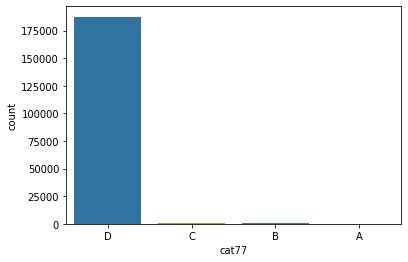

Frequency ---- D    99.567221
C     0.216655
B     0.190104
A     0.026020
Name: cat77, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


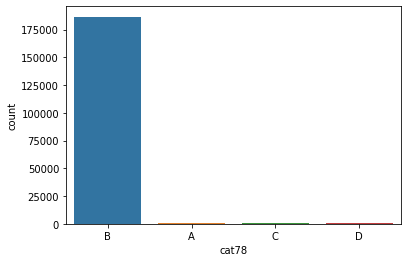

Frequency ---- B    99.048418
A     0.418441
C     0.342506
D     0.190635
Name: cat78, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


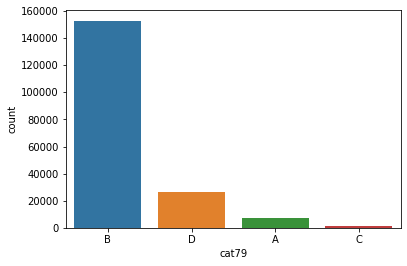

Frequency ---- B    81.207851
D    14.155312
A     3.751102
C     0.885736
Name: cat79, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


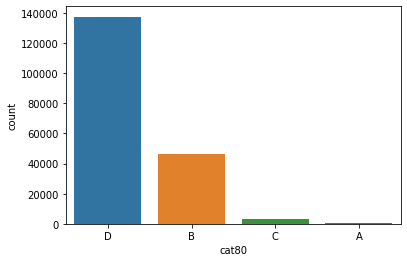

Frequency ---- D    73.017449
B    24.712454
C     1.854310
A     0.415786
Name: cat80, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


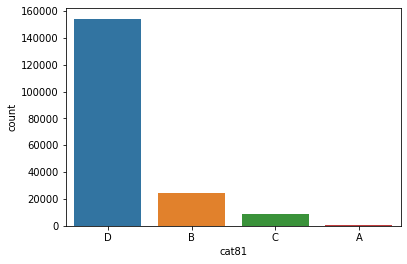

Frequency ---- D    81.981011
B    12.814495
C     4.786053
A     0.418441
Name: cat81, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


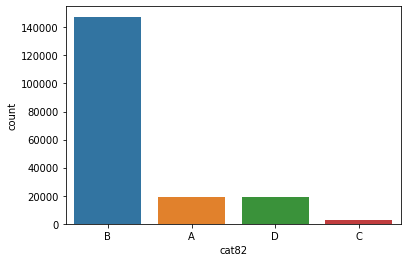

Frequency ---- B    78.344078
A    10.260304
D     9.985769
C     1.409849
Name: cat82, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


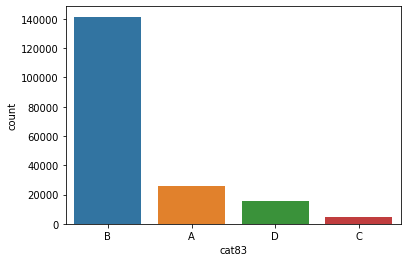

Frequency ---- B    75.156915
A    13.826612
D     8.383691
C     2.632781
Name: cat83, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


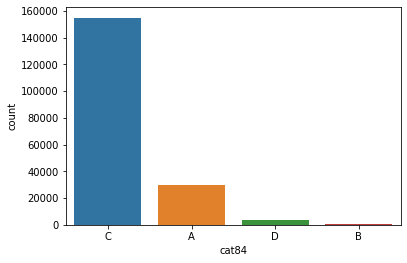

Frequency ---- C    82.275194
A    15.638441
D     1.857496
B     0.228868
Name: cat84, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


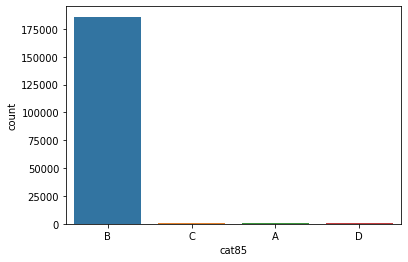

Frequency ---- B    98.771758
C     0.536858
A     0.418441
D     0.272943
Name: cat85, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


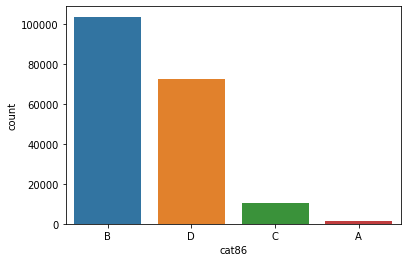

Frequency ---- B    55.147145
D    38.544908
C     5.464162
A     0.843786
Name: cat86, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


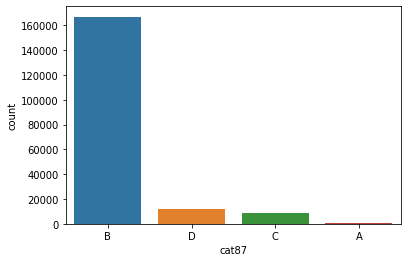

Frequency ---- B    88.675538
D     6.222985
C     4.683036
A     0.418441
Name: cat87, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


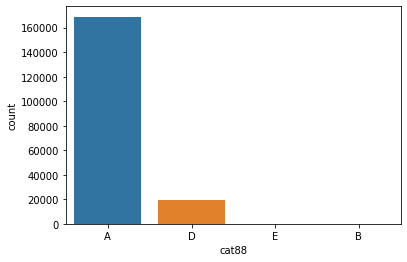

Frequency ---- A    89.702524
D    10.249684
E     0.044074
B     0.003717
Name: cat88, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


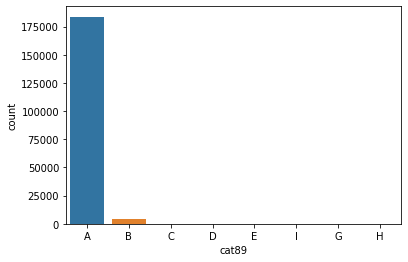

Frequency ---- A    97.571130
B     2.289744
C     0.116824
D     0.017524
E     0.002655
I     0.001062
G     0.000531
H     0.000531
Name: cat89, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


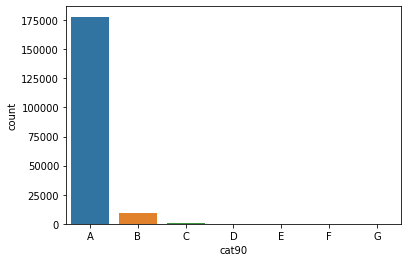

Frequency ---- A    94.517253
B     5.052624
C     0.386580
D     0.037171
E     0.003186
F     0.002124
G     0.001062
Name: cat90, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


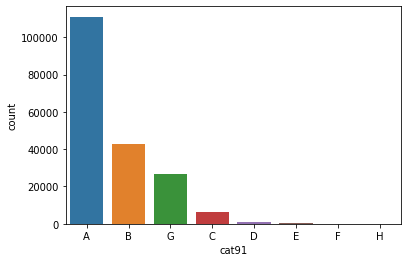

Frequency ---- A    58.957720
B    22.637241
G    14.196200
C     3.398507
D     0.610138
E     0.134878
F     0.051509
H     0.013806
Name: cat91, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


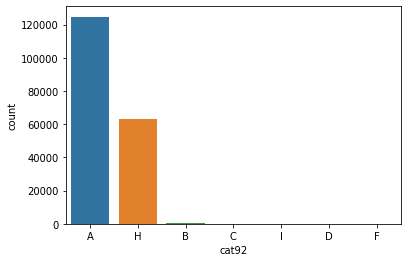

Frequency ---- A    66.211939
H    33.401480
B     0.333478
C     0.032923
I     0.013806
D     0.005841
F     0.000531
Name: cat92, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


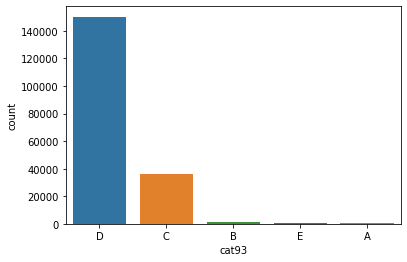

Frequency ---- D    79.778354
C    19.004025
B     0.601642
E     0.386580
A     0.229399
Name: cat93, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


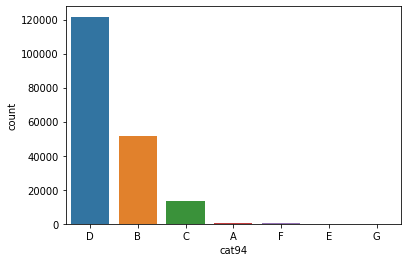

Frequency ---- D    64.593932
B    27.458873
C     7.234040
A     0.391890
F     0.262322
E     0.048323
G     0.010620
Name: cat94, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


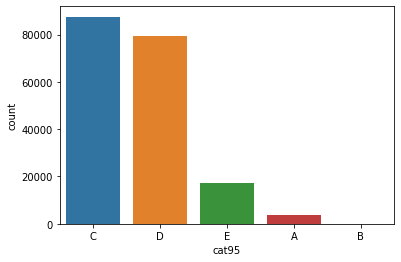

Frequency ---- C    46.480421
D    42.229102
E     9.248718
A     1.983878
B     0.057881
Name: cat95, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


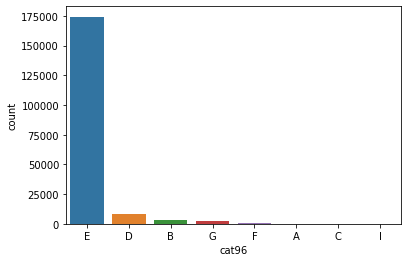

Frequency ---- E    92.588069
D     4.206714
B     1.570216
G     1.415159
F     0.182139
A     0.018586
C     0.012744
I     0.006372
Name: cat96, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


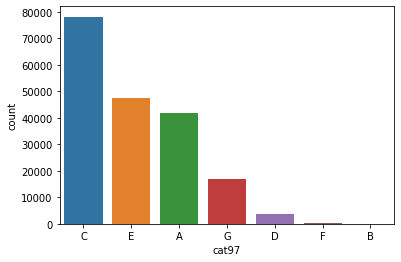

Frequency ---- C    41.486741
E    25.196742
A    22.286770
G     8.891874
D     2.006712
F     0.113107
B     0.018055
Name: cat97, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


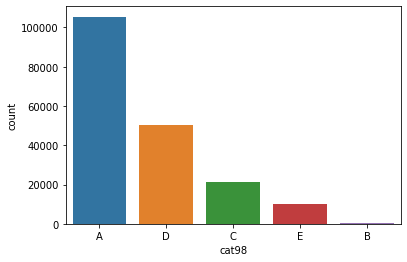

Frequency ---- A    56.018012
D    26.846611
C    11.408893
E     5.438673
B     0.287811
Name: cat98, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


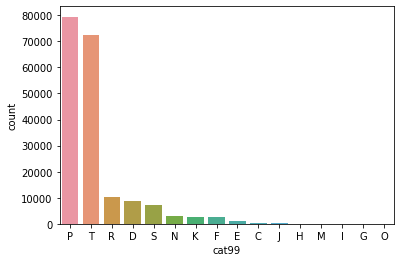

Frequency ---- P    42.191931
T    38.547032
R     5.464162
D     4.696312
S     3.741013
N     1.536762
K     1.435338
F     1.434807
E     0.549071
C     0.164615
J     0.130099
H     0.049385
M     0.027613
I     0.020179
G     0.010089
O     0.001593
Name: cat99, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


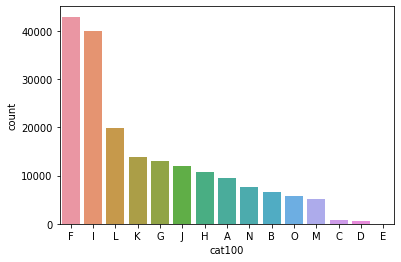

Frequency ---- F    22.817787
I    21.205089
L    10.599624
K     7.337058
G     6.868701
J     6.386538
H     5.722236
A     4.992619
N     4.031479
B     3.508958
O     3.025202
M     2.753322
C     0.443930
D     0.293652
E     0.013806
Name: cat100, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


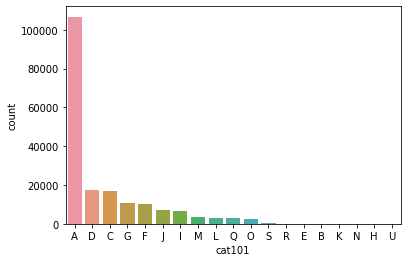

Frequency ---- A    56.670632
D     9.118087
C     9.011884
G     5.811447
F     5.383978
J     3.854650
I     3.552502
M     1.948300
L     1.684916
Q     1.466668
O     1.323825
S     0.091866
R     0.073280
E     0.003717
B     0.001593
K     0.001062
N     0.000531
H     0.000531
U     0.000531
Name: cat101, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


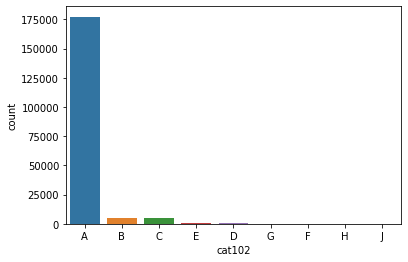

Frequency ---- A    94.135452
B     2.737391
C     2.617381
E     0.255950
D     0.238426
G     0.007965
F     0.006372
H     0.000531
J     0.000531
Name: cat102, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


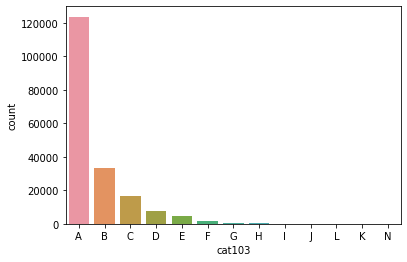

Frequency ---- A    65.706411
B    17.705158
C     8.766023
D     4.145116
E     2.375238
F     0.811393
G     0.292059
H     0.100893
I     0.057881
J     0.023896
L     0.009027
K     0.005841
N     0.001062
Name: cat103, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


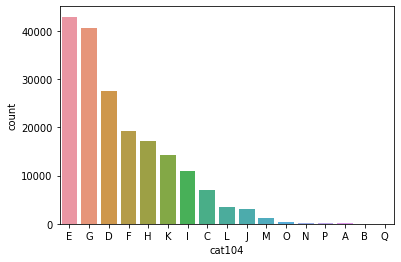

Frequency ---- E    22.793891
G    21.591138
D    14.661902
F    10.210389
H     9.126584
K     7.591946
I     5.798171
C     3.690035
L     1.851124
J     1.666330
M     0.613855
O     0.217186
N     0.081246
P     0.045667
A     0.036109
B     0.022834
Q     0.001593
Name: cat104, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


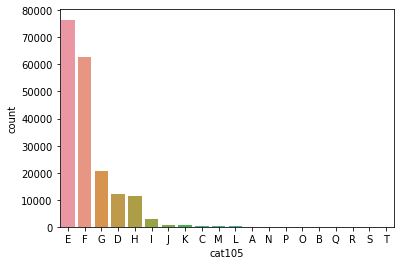

Frequency ---- E    40.619059
F    33.396701
G    10.945847
D     6.463535
H     5.978186
I     1.561720
J     0.368526
K     0.258074
C     0.146030
M     0.090804
L     0.076997
A     0.040888
N     0.033985
P     0.007965
O     0.004779
B     0.002655
Q     0.002124
R     0.001062
S     0.000531
T     0.000531
Name: cat105, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


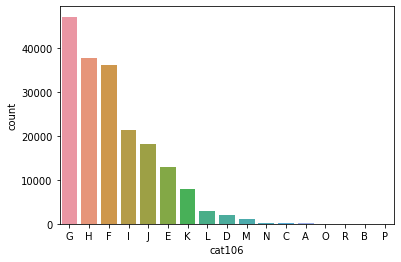

Frequency ---- G    25.045402
H    20.026232
F    19.192536
I    11.381281
J     9.707516
E     6.903217
K     4.225831
L     1.577651
D     1.026986
M     0.624476
N     0.122665
C     0.068501
A     0.039826
O     0.035047
R     0.016993
B     0.004779
P     0.001062
Name: cat106, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


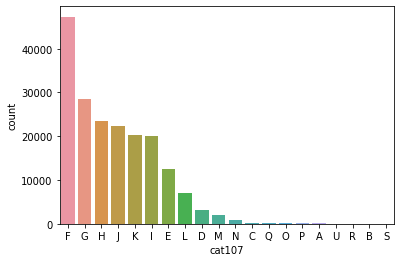

Frequency ---- F    25.122399
G    15.165837
H    12.458182
J    11.897429
K    10.745654
I    10.655381
E     6.648860
L     3.704372
D     1.712529
M     1.097611
N     0.423220
C     0.113107
Q     0.074342
O     0.066377
P     0.053102
A     0.039826
U     0.016993
R     0.002655
B     0.001062
S     0.001062
Name: cat107, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


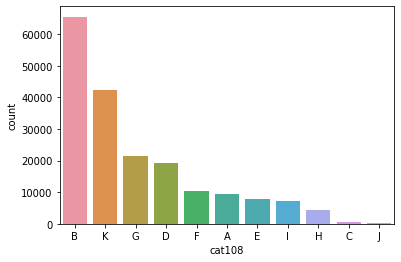

Frequency ---- B    34.787965
K    22.533693
G    11.374908
D    10.174280
F     5.438673
A     4.937924
E     4.231141
I     3.846154
H     2.286027
C     0.276129
J     0.113107
Name: cat108, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


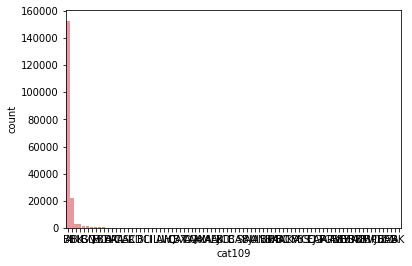

Frequency ---- BI    81.202009
AB    11.646789
BU     1.668454
K      1.592519
G      0.718466
        ...    
BF     0.000531
ZZ     0.000531
AG     0.000531
B      0.000531
AK     0.000531
Name: cat109, Length: 84, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


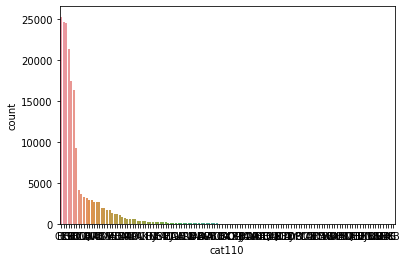

Frequency ---- CL    13.437377
EG    13.091685
CS    13.058762
EB    11.361633
CO     9.290137
        ...    
BD     0.000531
EH     0.000531
BK     0.000531
AS     0.000531
CB     0.000531
Name: cat110, Length: 131, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


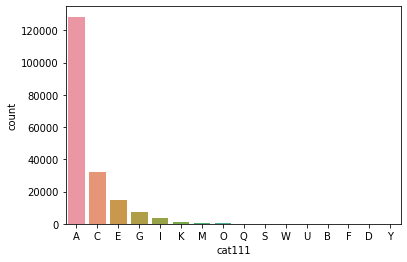

Frequency ---- A    68.179887
C    17.205472
E     7.796387
G     3.737826
I     1.899978
K     0.718466
M     0.251171
O     0.117355
Q     0.048323
S     0.020179
W     0.008496
U     0.008496
B     0.003717
F     0.001593
D     0.001593
Y     0.001062
Name: cat111, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


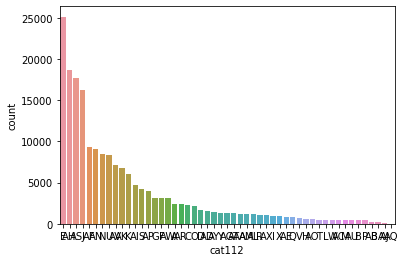

Frequency ---- E     13.354008
AH     9.897620
AS     9.382534
J      8.614153
AF     4.974564
AN     4.852430
N      4.488684
U      4.437175
AV     3.781901
AK     3.571618
K      3.217430
AI     2.521798
S      2.230801
AP     2.124067
G      1.682261
F      1.672172
AW     1.670047
A      1.280281
AR     1.255854
C      1.198505
O      1.159209
D      0.873522
AD     0.812987
AY     0.750858
Y      0.717404
AG     0.706783
AT     0.675453
AA     0.658992
AM     0.621290
AL     0.600049
R      0.596332
AX     0.570312
I      0.499156
X      0.491190
AE     0.442868
Q      0.421096
V      0.367995
H      0.290997
AO     0.283563
T      0.276660
L      0.261791
W      0.244799
AC     0.241082
M      0.233116
AU     0.230461
B      0.224620
P      0.215593
AB     0.130630
BA     0.100893
AJ     0.076466
AQ     0.015931
Name: cat112, dtype: float64
--------------------------------------------------------------------------------------------------------------------------------------------

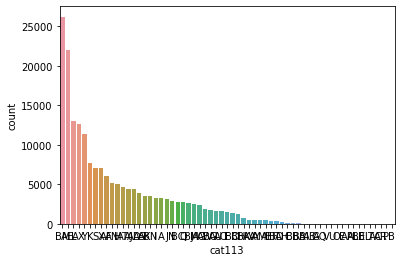

Frequency ---- BM    13.907858
AE    11.698298
L      6.934016
AX     6.723202
Y      6.039784
        ...    
T      0.001062
AC     0.000531
AR     0.000531
P      0.000531
B      0.000531
Name: cat113, Length: 61, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


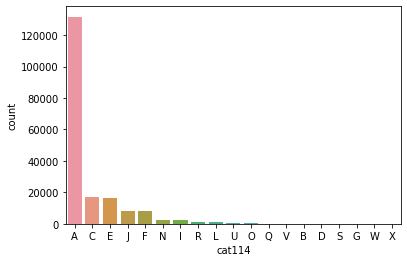

Frequency ---- A    69.931180
C     8.917363
E     8.748500
J     4.353806
F     4.197687
N     1.303646
I     1.291433
R     0.484287
L     0.461985
U     0.132754
O     0.127444
Q     0.022834
V     0.017524
B     0.003186
D     0.002655
S     0.002124
G     0.000531
W     0.000531
X     0.000531
Name: cat114, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


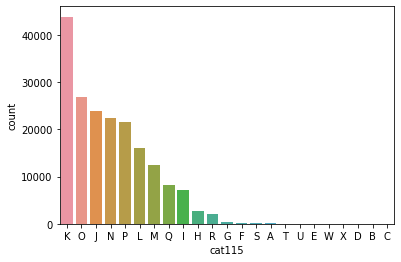

Frequency ---- K    23.293578
O    14.238150
J    12.688644
N    11.914952
P    11.437037
L     8.562644
M     6.607972
Q     4.385136
I     3.764908
H     1.483130
R     1.082212
G     0.167270
F     0.142843
S     0.132754
A     0.039826
T     0.029737
U     0.013806
E     0.005841
W     0.003186
X     0.002655
D     0.002124
B     0.001062
C     0.000531
Name: cat115, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


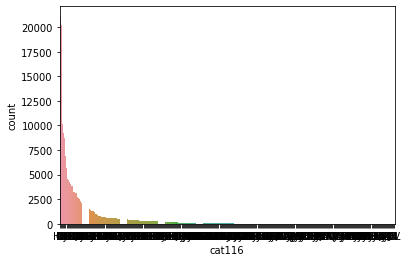

Frequency ---- HK    11.183742
DJ    10.749902
CK     5.396192
DP     4.886416
GS     4.638962
        ...    
AH     0.000531
FN     0.000531
IX     0.000531
EV     0.000531
BL     0.000531
Name: cat116, Length: 326, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


In [ ]:
for col in cat_features:
  sns.countplot(x=train_data[col],data=train_data,order=train_data[col].value_counts().keys())
  plt.show()
  print('Frequency ----',train_data[col].value_counts()/train_data.shape[0]*100)
  print('-----------'*20)

cat1 to cat72 have only two labels A and B. In most of the cases, B has very few entries.

cat73 to cat 108 have more than two labels.

cat109 to cat116 have many labels.

**Numerical Data Analysis**

**Statistical description of numerical features.**

In [ ]:
train_data[num_features].describe()

,cont1,cont2,cont3,cont4,cont5,cont6,cont7,cont8,cont9,cont10,cont11,cont12,cont13,cont14,loss
count,188318.000000,188318.000000,188318.000000,188318.000000,188318.000000,188318.000000,188318.000000,188318.000000,188318.000000,188318.000000,188318.000000,188318.000000,188318.000000,188318.000000,188318.000000
mean,0.493861,0.507188,0.498918,0.491812,0.487428,0.490945,0.484970,0.486437,0.485506,0.498066,0.493511,0.493150,0.493138,0.495717,3037.337686
std,0.187640,0.207202,0.202105,0.211292,0.209027,0.205273,0.178450,0.199370,0.181660,0.185877,0.209737,0.209427,0.212777,0.222488,2904.086186
min,0.000016,0.001149,0.002634,0.176921,0.281143,0.012683,0.069503,0.236880,0.000080,0.000000,0.035321,0.036232,0.000228,0.179722,0.670000
25%,0.346090,0.358319,0.336963,0.327354,0.281143,0.336105,0.350175,0.312800,0.358970,0.364580,0.310961,0.311661,0.315758,0.294610,1204.460000
50%,0.475784,0.555782,0.527991,0.452887,0.422268,0.440945,0.438285,0.441060,0.441450,0.461190,0.457203,0.462286,0.363547,0.407403,2115.570000
75%,0.623912,0.681761,0.634224,0.652072,0.643315,0.655021,0.591045,0.623580,0.566820,0.614590,0.678924,0.675759,0.689974,0.724623,3864.045000
max,0.984975,0.862654,0.944251,0.954297,0.983674,0.997162,1.000000,0.980200,0.995400,0.994980,0.998742,0.998484,0.988494,0.844848,121012.250000


All continuous features have been scaled to [0,1] interval and have means around 0.5 and standard deviation is not more than 0.22.Loss values are not scaled.

**Skewness of features**

cont1 ----skew--- 0.5164240212162501


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


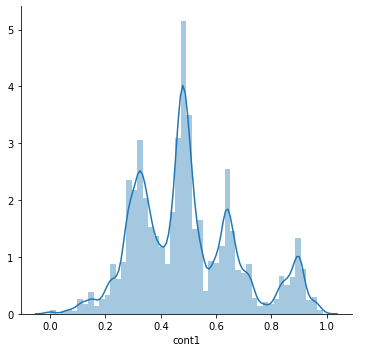

------------------------------------------------------------------------------------------------------------------------
cont2 ----skew--- -0.3109412513683013


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


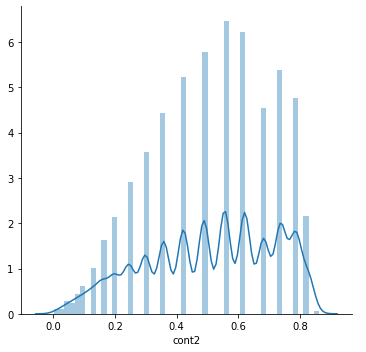

------------------------------------------------------------------------------------------------------------------------
cont3 ----skew--- -0.010002283912088425


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


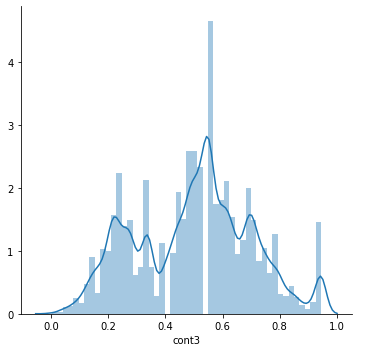

------------------------------------------------------------------------------------------------------------------------
cont4 ----skew--- 0.41609602949567703


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


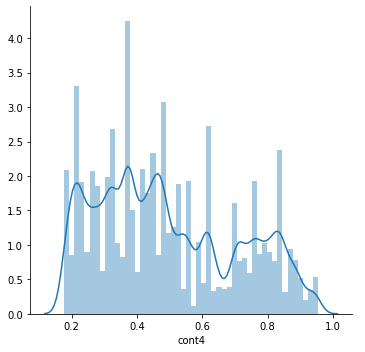

------------------------------------------------------------------------------------------------------------------------
cont5 ----skew--- 0.6816224364137877


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


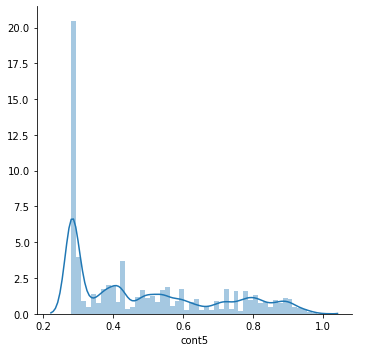

------------------------------------------------------------------------------------------------------------------------
cont6 ----skew--- 0.4612142679626868


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


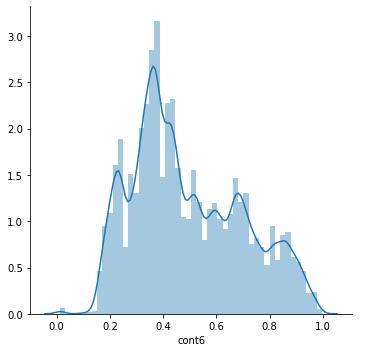

------------------------------------------------------------------------------------------------------------------------
cont7 ----skew--- 0.8260528331279865


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


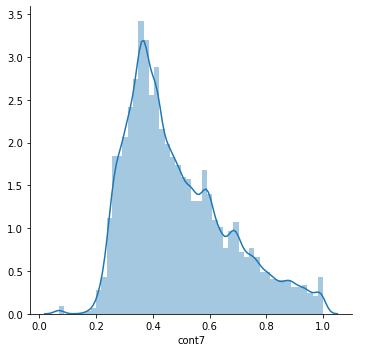

------------------------------------------------------------------------------------------------------------------------
cont8 ----skew--- 0.6766340713246528


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


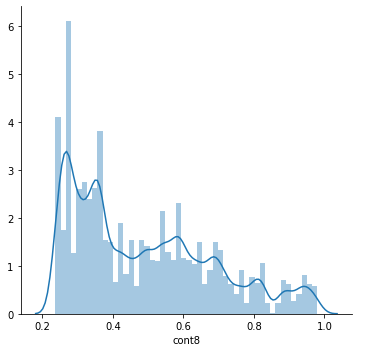

------------------------------------------------------------------------------------------------------------------------
cont9 ----skew--- 1.0724287198115823


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


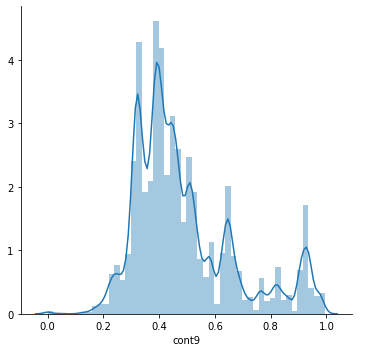

------------------------------------------------------------------------------------------------------------------------
cont10 ----skew--- 0.35500094742512944


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


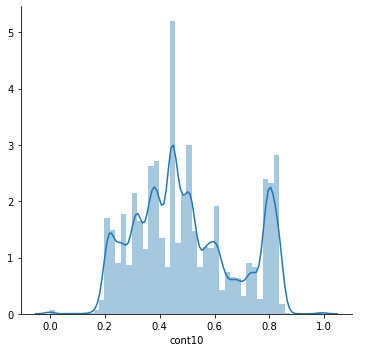

------------------------------------------------------------------------------------------------------------------------
cont11 ----skew--- 0.28082142843754204


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


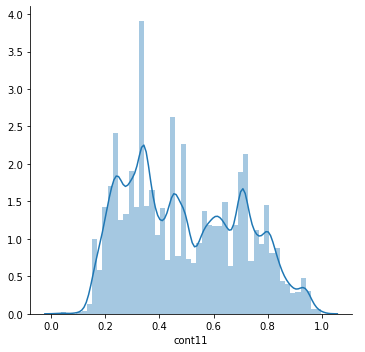

------------------------------------------------------------------------------------------------------------------------
cont12 ----skew--- 0.29199208040362884


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


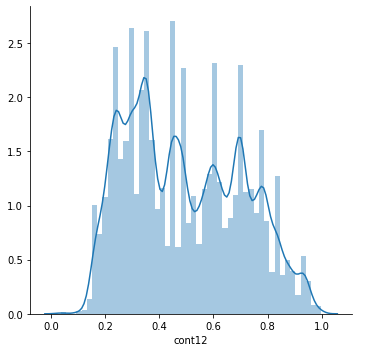

------------------------------------------------------------------------------------------------------------------------
cont13 ----skew--- 0.38074220048057467


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


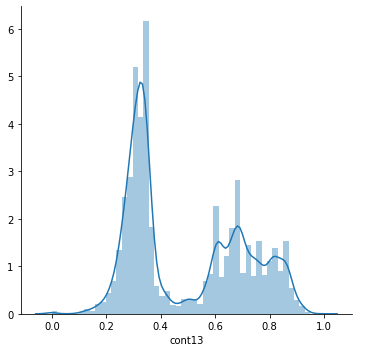

------------------------------------------------------------------------------------------------------------------------
cont14 ----skew--- 0.24867408719289721


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


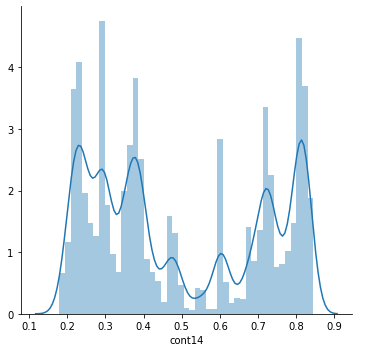

------------------------------------------------------------------------------------------------------------------------
loss ----skew--- 3.7949583775378604


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


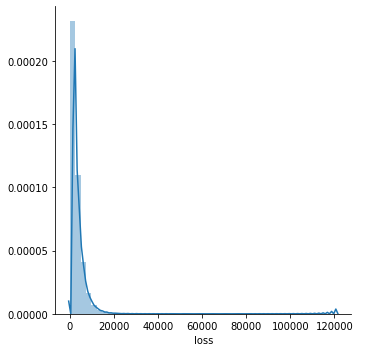

------------------------------------------------------------------------------------------------------------------------


In [ ]:
for col in num_features:
  print(col,'----skew---',train_data[col].skew())
  sns.FacetGrid(data=train_data,size=5).map(sns.distplot,col).add_legend()
  plt.show()
  print('------'*20)

Skewness of numerical features if any feature is skewed it is recommended to fix skewness and make data more uniform in distribution.Need to correct skew on Loss column.

Loss data is skewed and unevenly distributed.Need to apply log transformation on loss feature. 

skew after transformation --- 0.30141134059861313


/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


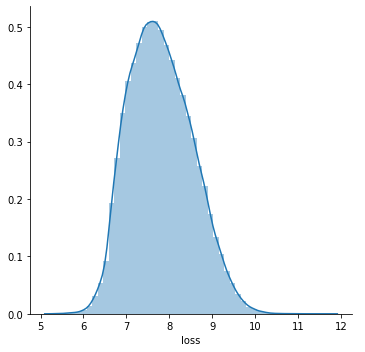

In [ ]:
train_data['loss'] = np.log(train_data['loss']+200) 
print('skew after transformation ---',train_data['loss'].skew())
sns.FacetGrid(data=train_data,size=5).map(sns.distplot,'loss').add_legend()
plt.show()

Skew correction applied log transformation to the target label with shift value 200.

Why shift 200?
It makes distribution more symmetric[Log undefined for zero and nan values].


**Correlation between features**

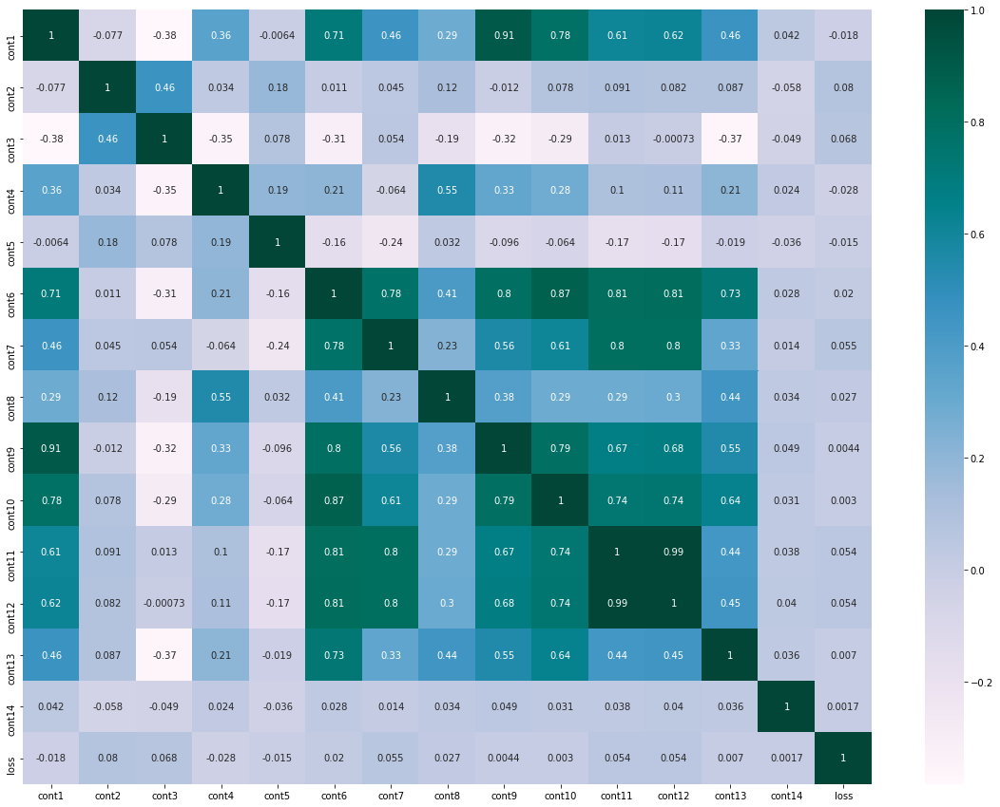

In [ ]:
plt.subplots(figsize=(20,15))
sns.heatmap(train_data[num_features].corr('spearman'), annot=True, cmap="PuBuGn", xticklabels=num_features, yticklabels=num_features)
plt.show()

To find correlation among continuous features used pandas .corr() method and pass it to the seaborn heatmap to visualize Pearson correlation coefficient. From the figure we can see that the lighter region in the heatmap shows strong correlation and darker region depicts weaker correlation among features.

Features showing strong correlation are listed below.

Cont11 and cont12,
Cont1 and cont9,
Cont6 and cont10,
Cont1 and cont10.
 



**Highly corelated features**

In [ ]:
num_data = train_data[num_features].corr()
for col in num_features[:-1]:
  corr_data = num_data[col].values.tolist()
  hcl = [corr_data.index(val)+1 for val in sorted(corr_data,reverse=True)[1:] if val > 0.8]
  if len(hcl)!=0:
    print(col,'--correlated with-- features',[num_data.columns[val-1] for val in hcl])

cont1 --correlated with-- features ['cont9', 'cont10']
cont6 --correlated with-- features ['cont10', 'cont13']
cont9 --correlated with-- features ['cont1']
cont10 --correlated with-- features ['cont6', 'cont1']
cont11 --correlated with-- features ['cont12']
cont12 --correlated with-- features ['cont11']
cont13 --correlated with-- features ['cont6']


**Data interaction between highly corelated features**

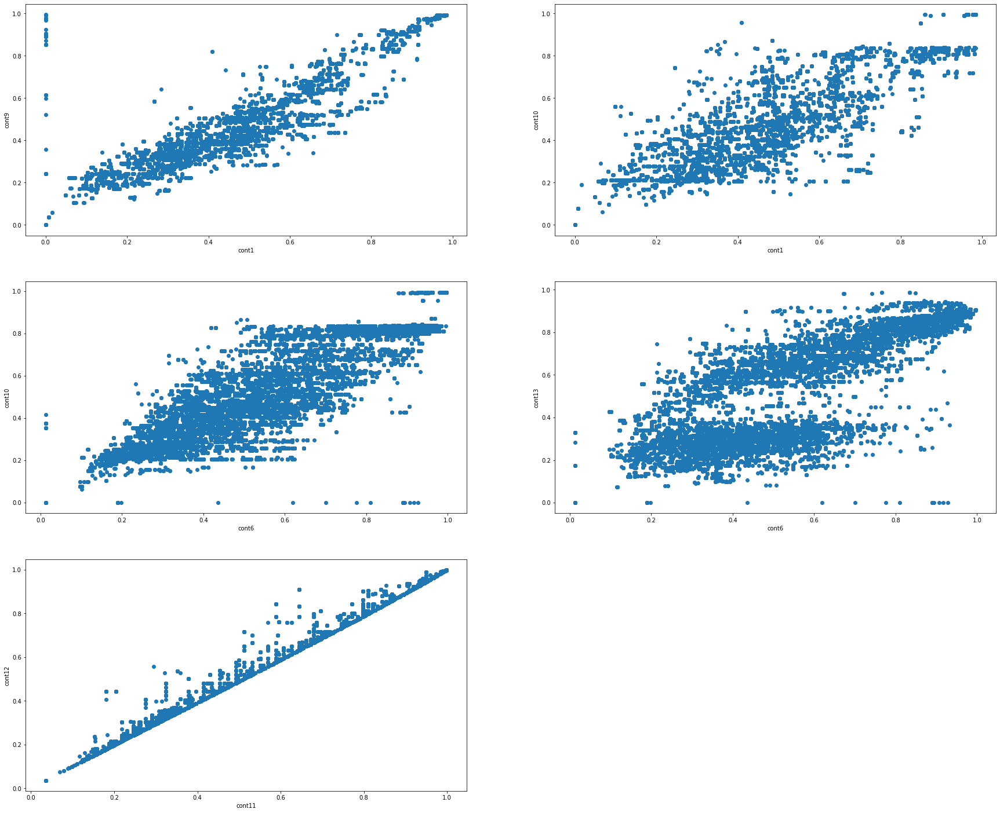

In [ ]:
plt.figure(figsize=(30,25))
plt.subplot(321)
plt.xlabel('cont1')
plt.ylabel('cont9')
plt.scatter(train_data['cont1'],train_data['cont9'])
plt.subplot(322)
plt.xlabel('cont1')
plt.ylabel('cont10')
plt.scatter(train_data['cont1'],train_data['cont10'])
plt.subplot(323)
plt.xlabel('cont6')
plt.ylabel('cont10')
plt.scatter(train_data['cont6'],train_data['cont10'])
plt.subplot(324)
plt.xlabel('cont6')
plt.ylabel('cont13')
plt.scatter(train_data['cont6'],train_data['cont13'])
plt.subplot(325)
plt.xlabel('cont11')
plt.ylabel('cont12')
plt.scatter(train_data['cont11'],train_data['cont12'])
plt.show()

cont11 and cont12 give an almost linear pattern.

cont1 and cont9 are highly correlated.

cont6 and cont10 show very good correlation too


**Pairplot on numerical features**

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:2079: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


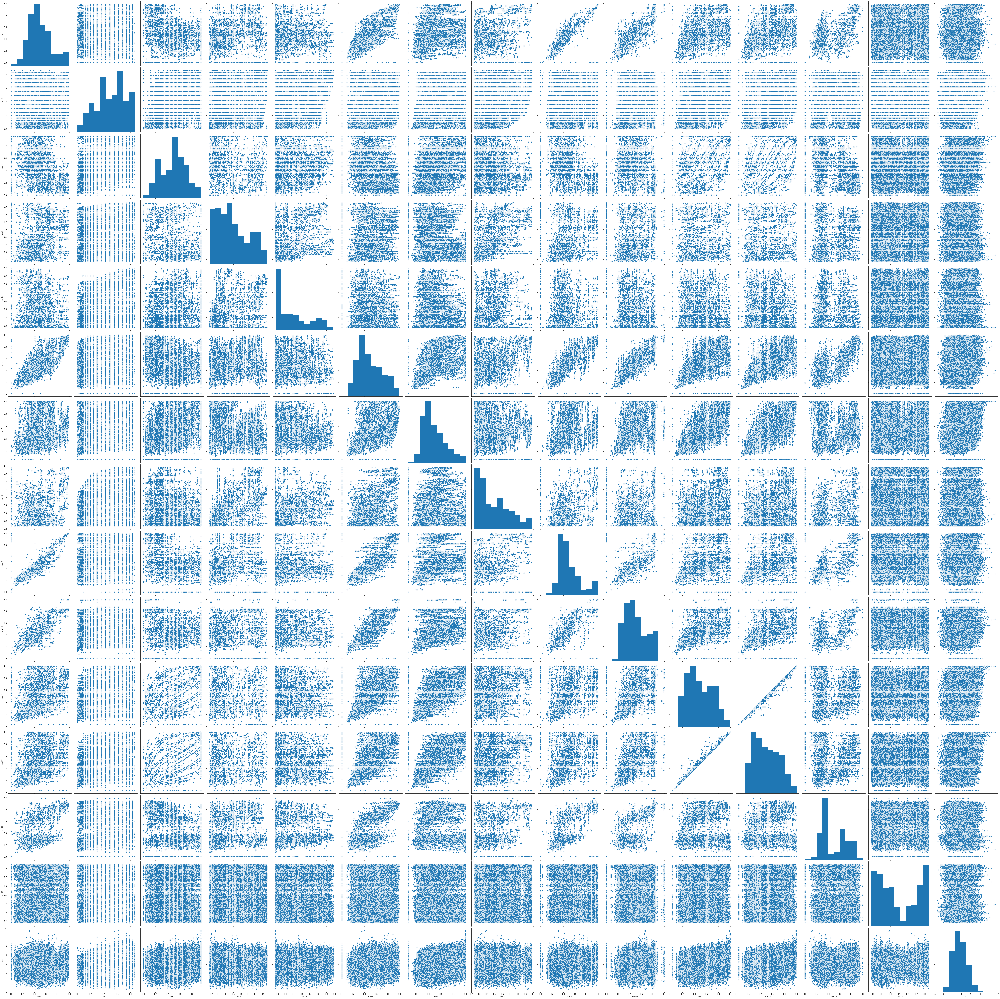

In [ ]:
num_pairs = train_data[num_features]
sns.pairplot(num_pairs,size=5)

All features are uncorrelated with loss.

(cont11 , cont12) ,(cont1 , cont9) features are highly corelated[data-based multicollinearity].

**Ouliers analysis on numerical feature**

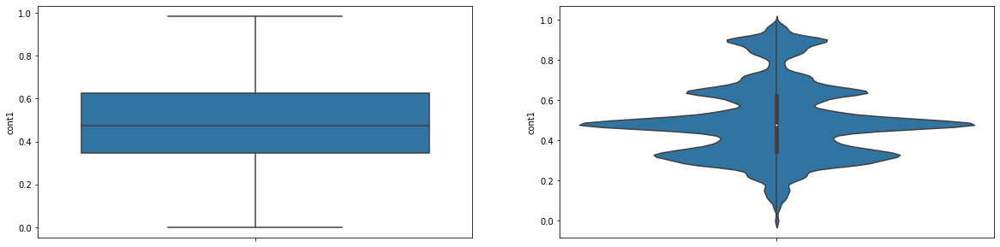

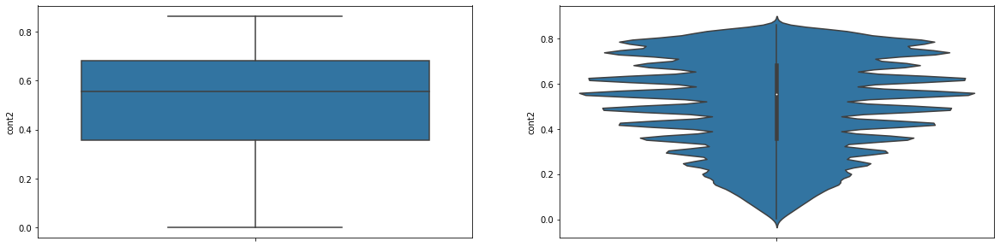

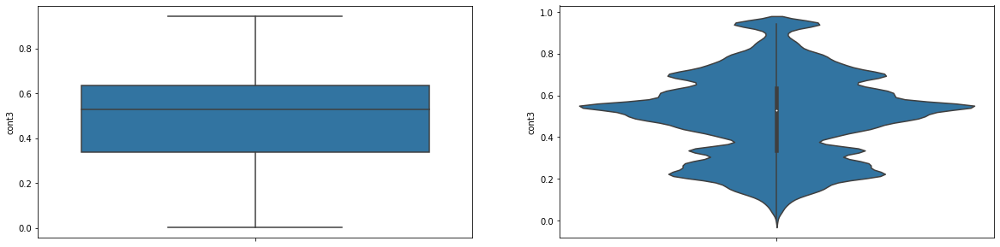

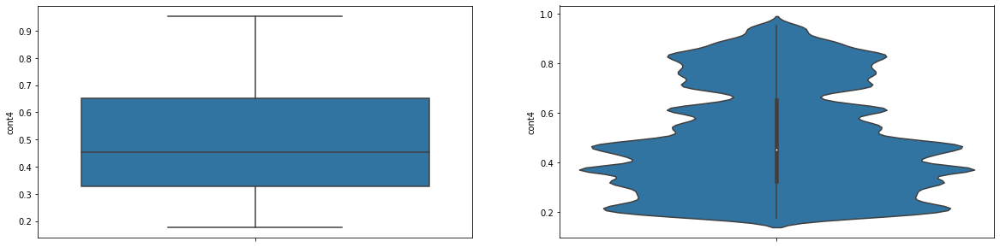

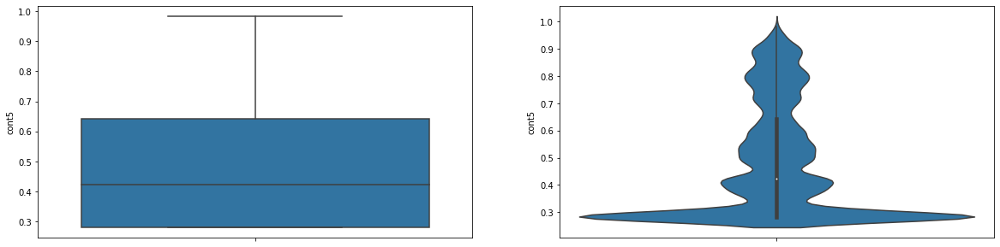

...

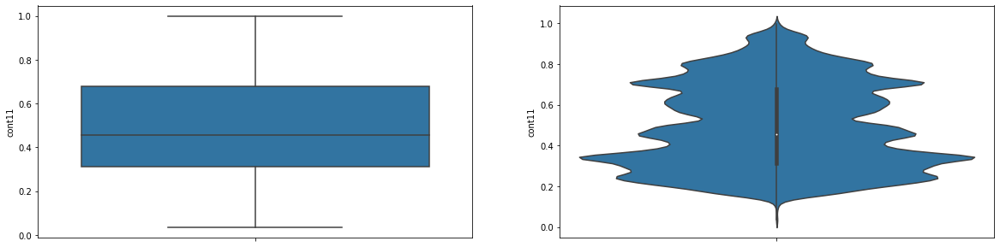

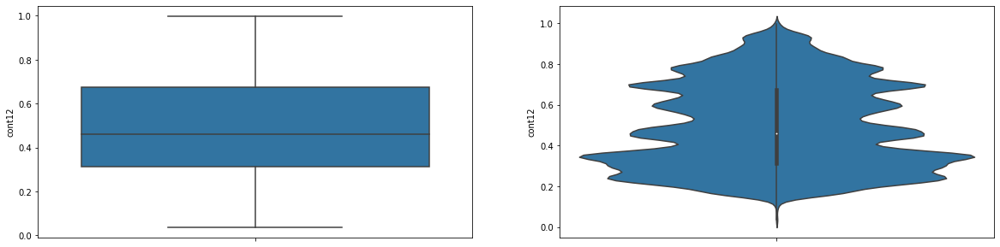

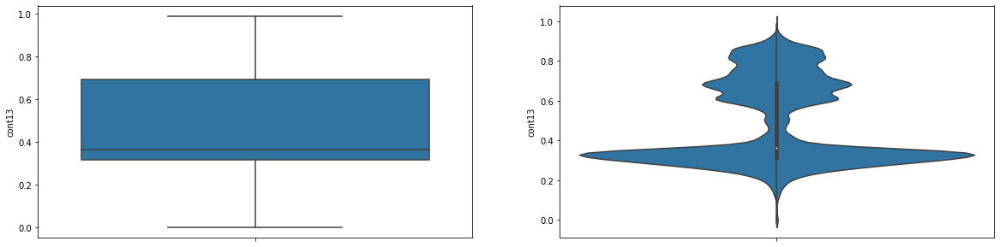

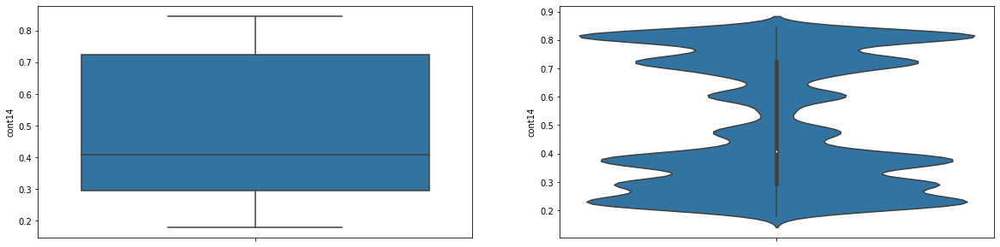

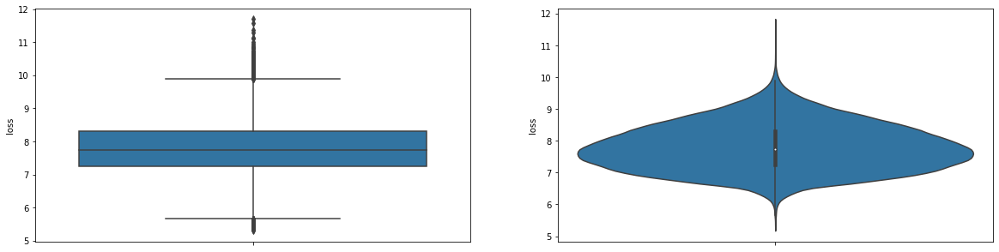

In [ ]:
for col in num_features:
  plt.figure(figsize=(20,5))
  plt.subplot(121)
  sns.boxplot(y=col,data=num_pairs)
  plt.subplot(122)
  sns.violinplot(y=col,data=num_pairs)
  plt.show()

cont1 has many values close to 0.5.

cont2 has a pattern where there a several spikes at specific points.

cont5 has many values near 0.3.

cont14 has a distinct pattern. 0.22 and 0.82 have a lot of concentration.

cont9 and cont10 ,cont7 features having outliers.


**IQR(1.5) rule to detect outliers in numerical feature**

In [ ]:
for col in num_features:
  per_25 = train_data[col].describe()[4]
  per_75 = train_data[col].describe()[6]
  iqr = per_75 - per_25

  per_75 += 1.5*iqr
  per_25 -= 1.5*iqr
  print('No of outliers in feature ',col,'  ',list(train_data[col]>per_75).count(True)+list(train_data[col]<per_25).count(True))


No of outliers in feature  cont1    0
No of outliers in feature  cont2    0
No of outliers in feature  cont3    0
No of outliers in feature  cont4    0
No of outliers in feature  cont5    0
No of outliers in feature  cont6    0
No of outliers in feature  cont7    2659
No of outliers in feature  cont8    0
No of outliers in feature  cont9    13194
No of outliers in feature  cont10    140
No of outliers in feature  cont11    0
No of outliers in feature  cont12    0
No of outliers in feature  cont13    0
No of outliers in feature  cont14    0
No of outliers in feature  loss    510


**Data Preprocessing**

will perform feature engineering based on data exploration and analysis done in prior section

**Training data splitting**

In [5]:
X = train_data.drop(columns=['loss'],axis='columns')
y = train_data['loss']
 
#X_train, X_cv, y_train, y_cv = train_test_split(X, y, test_size=0.1, random_state=42)

Train data will be input to model for regression training. Once the model is trained, prediction will be done on cv data.

We have used sklearn model.selection train_test_split function to split original transformed data into train and cv dataset. Split ratio is 9:1 that is 10% will be used as cv data and 90% as train data.

**Encoding categorical features**

In [7]:
from sklearn.externals import joblib

cat_onehot_encode_num_features_train = []
#cat_onehot_encode_num_features_cv = []
cat_onehot_encode_num_features_test = []

for col in cat_features:
    vectorizer = CountVectorizer(token_pattern=r"(?u)\b\w+\b")
    vectorizer.fit(X[col].values)
    joblib.dump(vectorizer,'/content/drive/My Drive/Colab Notebooks/'+col+'.pkl')

    cat_onehot_encode_num_features_train.append(vectorizer.transform(X[col].values))
    #cat_onehot_encode_num_features_cv.append(vectorizer.transform(X_cv[col].values))
    cat_onehot_encode_num_features_test.append(vectorizer.transform(test_data[col].values))

/usr/local/lib/python3.6/dist-packages/sklearn/externals/joblib/__init__.py:15: FutureWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=FutureWarning)


Categorical variables will be one hot encoded to numeric values from string values as we can only input numeric values to model for training. One hot encoding is done through **CountVectorizer**  which converts all categorical variable into one hot representation of numeric values. After one hot encoding we observe 116 categorical features are converted into 1128 numeric features

**Encoding numerical features**

In [ ]:
for col in num_features:
  if col not in ['loss']:
    cat_onehot_encode_num_features_train.append(X[col].values.reshape(-1,1))
    #cat_onehot_encode_num_features_cv.append(X_cv[col].values.reshape(-1,1))
    cat_onehot_encode_num_features_test.append(test_data[col].values.reshape(-1,1))

**Final Data**

In [ ]:
#X_train = hstack((cat_onehot_encode_num_features_train)).tocsr()
X_tr = hstack((cat_onehot_encode_num_features_train)).tocsr()
#X_cv = hstack((cat_onehot_encode_num_features_cv)).tocsr()
X_te = hstack((cat_onehot_encode_num_features_test)).tocsr()
print(X_tr.shape)

(188318, 1153)


Concatenation of categorical and numerical features using hstack().

hstack() function will stack the sequence of inputs horizontally column wise

**KPA**

Chosen MAE as KPA[If we apply log or box-cox transformation on target feature MAE should calculate between exponential actual and predicted values. While calculating MAE we have to subtract shift value from both actual and predicted value]

In this problem statement, prediction of loss value is performed which is numerical quantity. Predicting numerical value from input features is the case of linear regression. Closer the predicted value to actual, lesser the error term and more accurate regression function can be approximated.



In [ ]:
submission_data = pd.read_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_actual.csv')

**Linear Regression**

In [ ]:
def mae_score(y_true, y_pred):
  return mean_absolute_error(np.exp(y_true)-200,np.exp(y_pred)-200)

mae_scorer = make_scorer(mae_score, greater_is_better=False)

**Hyperparameters tuning for Linear Regression**

Alpha : Constant that multiplies the regularization term. Also used to compute learning_rate when set to ‘optimal’.

eta0 : The initial learning rate for the ‘constant’.

n_iter : Number of iterations with no improvement to wait before early stopping.

In [ ]:
alpha = [10 ** x for x in range(-5, 1)]
eta   = [10 ** x for x in range(-5, -1)]
n_iter = [5,10,15,20]

params = {"alpha":alpha,"eta0":eta,"n_iter_no_change":n_iter}

model_ra = RandomizedSearchCV(SGDRegressor(),params,cv=3,random_state=42,scoring=mae_scorer)
model_ra.fit(X_tr,y)

RandomizedSearchCV(cv=3, error_score=nan,
                   estimator=SGDRegressor(alpha=0.0001, average=False,
                                          early_stopping=False, epsilon=0.1,
                                          eta0=0.01, fit_intercept=True,
                                          l1_ratio=0.15,
                                          learning_rate='invscaling',
                                          loss='squared_loss', max_iter=1000,
                                          n_iter_no_change=5, penalty='l2',
                                          power_t=0.25, random_state=None,
                                          shuffle=True, tol=0.001,
                                          validation_fraction=0.1, verbose=0,
                                          warm_start=False),
                   iid='deprecated', n_iter=10, n_jobs=None,
                   param_distributions={'alpha': [1e-05, 0.0001, 0.001, 0.01,
                                    

In [ ]:
pd.DataFrame.from_dict(model_ra.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_iter_no_change,param_eta0,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,3.178840,0.177879,0.022839,0.000111,5,1e-05,1,"{'n_iter_no_change': 5, 'eta0': 1e-05, 'alpha'...",-1708.095959,-1714.340858,-1695.287972,-1705.908263,7.930642,10
1,1.258913,0.012439,0.022434,0.000126,10,0.01,0.1,"{'n_iter_no_change': 10, 'eta0': 0.01, 'alpha'...",-1329.462851,-1326.973345,-1306.146252,-1320.860816,10.454288,5
2,1.404501,0.046350,0.022906,0.000203,10,0.001,0.1,"{'n_iter_no_change': 10, 'eta0': 0.001, 'alpha...",-1312.049356,-1325.537411,-1311.476105,-1316.354290,6.497663,4
3,1.848231,0.026358,0.023276,0.000047,15,0.01,1,"{'n_iter_no_change': 15, 'eta0': 0.01, 'alpha'...",-1666.237380,-1657.163280,-1691.065038,-1671.488566,14.329771,9
4,5.024596,0.045463,0.022901,0.000242,10,1e-05,0.001,"{'n_iter_no_change': 10, 'eta0': 1e-05, 'alpha...",-1462.413366,-1473.307824,-1456.712155,-1464.144448,6.884840,7
5,2.287683,0.044321,0.022948,0.000144,20,0.01,0.1,"{'n_iter_no_change': 20, 'eta0': 0.01, 'alpha'...",-1309.195615,-1319.393397,-1308.340843,-1312.309952,5.020893,3
6,2.128430,0.025627,0.022787,0.000309,10,0.0001,0.1,"{'n_iter_no_change': 10, 'eta0': 0.0001, 'alph...",-1328.623158,-1340.676374,-1325.384953,-1331.561495,6.579375,6
7,1.958175,0.064316,0.022499,0.000047,15,0.001,0.001,"{'n_iter_no_change': 15, 'eta0': 0.001, 'alpha...",-1241.698488,-1248.953911,-1237.901850,-1242.851416,4.585044,2
8,4.533838,0.046692,0.022658,0.000389,5,1e-05,1e-05,"{'n_iter_no_change': 5, 'eta0': 1e-05, 'alpha'...",-1478.894081,-1486.052015,-1472.327501,-1479.091199,5.604743,8
9,1.992943,0.061272,0.023034,0.000403,15,0.001,1e-05,"{'n_iter_no_change': 15, 'eta0': 0.001, 'alpha...",-1243.214202,-1247.923205,-1236.192292,-1242.443233,4.820054,1


In [ ]:
model_ra.best_params_

{'alpha': 1e-05, 'eta0': 0.001, 'n_iter_no_change': 15}

In [ ]:
model_linear = SGDRegressor(alpha=1e-05, eta0=0.001, n_iter_no_change= 15)
model_linear.fit(X_tr,y)
y_test_sub = np.exp(model_linear.predict(X_te))-200
submission_data['loss'] = y_test_sub
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_LR.csv')

![alt text](https://drive.google.com/uc?id=18rvbAoN0-C1kx9DWsasLyg5fNGRc6ysV)

**LinearRegressor** model training is done on train data with default parameters to get MAE. As we can see resulted MAE of 1243.21 is better than   **KNN**.

**Support vector machine**

In [ ]:
alpha = [10 ** x for x in range(-5, 1)]
eta   = [10 ** x for x in range(-5, -1)]
n_iter = [5,10,15,20]

params = {"alpha":alpha,"eta0":eta,"n_iter_no_change":n_iter}

model_sv_ra = RandomizedSearchCV(SGDRegressor(loss='huber'),params,cv=3,random_state=42,scoring=mae_scorer)
model_sv_ra.fit(X_tr,y)

RandomizedSearchCV(cv=3, error_score=nan,
                   estimator=SGDRegressor(alpha=0.0001, average=False,
                                          early_stopping=False, epsilon=0.1,
                                          eta0=0.01, fit_intercept=True,
                                          l1_ratio=0.15,
                                          learning_rate='invscaling',
                                          loss='huber', max_iter=1000,
                                          n_iter_no_change=5, penalty='l2',
                                          power_t=0.25, random_state=None,
                                          shuffle=True, tol=0.001,
                                          validation_fraction=0.1, verbose=0,
                                          warm_start=False),
                   iid='deprecated', n_iter=10, n_jobs=None,
                   param_distributions={'alpha': [1e-05, 0.0001, 0.001, 0.01,
                                           

In [ ]:
pd.DataFrame.from_dict(model_sv_ra.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_iter_no_change,param_eta0,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,5.480215,0.004760,0.024158,0.000362,5,1e-05,1,"{'n_iter_no_change': 5, 'eta0': 1e-05, 'alpha'...",-2372.668166,-2380.716150,-2370.085015,-2374.489777,4.527248,10
1,1.391492,0.007680,0.023650,0.000179,10,0.01,0.1,"{'n_iter_no_change': 10, 'eta0': 0.01, 'alpha'...",-1638.694954,-1630.164255,-1618.800115,-1629.219775,8.149445,3
2,1.516422,0.002351,0.024258,0.000705,10,0.001,0.1,"{'n_iter_no_change': 10, 'eta0': 0.001, 'alpha...",-1630.843817,-1640.129123,-1626.974899,-1632.649279,5.519853,4
3,1.947638,0.013903,0.025622,0.002857,15,0.01,1,"{'n_iter_no_change': 15, 'eta0': 0.01, 'alpha'...",-2310.553976,-2281.300733,-2284.014730,-2291.956480,13.197009,9
4,3.836788,0.007083,0.023855,0.000114,10,1e-05,0.001,"{'n_iter_no_change': 10, 'eta0': 1e-05, 'alpha...",-1993.256455,-1997.749453,-1982.661874,-1991.222594,6.325146,7
5,2.507662,0.012411,0.023778,0.000156,20,0.01,0.1,"{'n_iter_no_change': 20, 'eta0': 0.01, 'alpha'...",-1635.659498,-1642.508258,-1633.731493,-1637.299750,3.766140,5
6,1.813065,0.055027,0.023646,0.000353,10,0.0001,0.1,"{'n_iter_no_change': 10, 'eta0': 0.0001, 'alph...",-1778.881875,-1777.154454,-1762.694126,-1772.910152,7.258162,6
7,2.170598,0.002952,0.023688,0.000242,15,0.001,0.001,"{'n_iter_no_change': 15, 'eta0': 0.001, 'alpha...",-1272.302227,-1283.655073,-1268.717541,-1274.891614,6.367164,2
8,3.259189,0.006534,0.023800,0.000382,5,1e-05,1e-05,"{'n_iter_no_change': 5, 'eta0': 1e-05, 'alpha'...",-1998.216356,-2002.703042,-1987.832703,-1996.250700,6.227873,8
9,2.173122,0.010067,0.024913,0.001446,15,0.001,1e-05,"{'n_iter_no_change': 15, 'eta0': 0.001, 'alpha...",-1271.345335,-1282.077301,-1267.658582,-1273.693739,6.116160,1


In [ ]:
model_sv_ra.best_params_

{'alpha': 1e-05, 'eta0': 0.001, 'n_iter_no_change': 15}

In [ ]:
model_svm = SGDRegressor(loss='huber',alpha= 1e-05, eta0=0.001, n_iter_no_change= 15)
model_svm.fit(X_tr,y)
y_test_svm = np.exp(model_svm.predict(X_te))-200
submission_data['loss'] = y_test_svm
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_svm.csv')

![alt text](https://drive.google.com/uc?id=1v47cPP5ncmTPM29kN9biWrHjyvJRoXTE)

**SVC** model training is done on train data with alpha , eta , iterations as a hyper parameters. As we can see resulted MAE of 1271.345 is worst than   **LinearRegression**.



**DecisionTree**

In [ ]:
depth = [x for x in range(1,51)]
split = [x for x in range(2,100)]

depth_params = {"max_depth":depth,"min_samples_split":split}
model_de_ra = RandomizedSearchCV(DecisionTreeRegressor(),depth_params,cv=3,random_state=42,scoring=mae_scorer)
model_de_ra.fit(X_tr,y)

RandomizedSearchCV(cv=3, error_score=nan,
                   estimator=DecisionTreeRegressor(ccp_alpha=0.0,
                                                   criterion='mse',
                                                   max_depth=None,
                                                   max_features=None,
                                                   max_leaf_nodes=None,
                                                   min_impurity_decrease=0.0,
                                                   min_impurity_split=None,
                                                   min_samples_leaf=1,
                                                   min_samples_split=2,
                                                   min_weight_fraction_leaf=0.0,
                                                   presort='deprecated',
                                                   random_state=None,
                                                   splitter='best'),
                   iid='d

In [ ]:
pd.DataFrame.from_dict(model_de_ra.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_min_samples_split,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,16.836707,1.062841,0.051845,0.000117,78,9,"{'min_samples_split': 78, 'max_depth': 9}",-1306.105492,-1306.268781,-1305.876717,-1306.083663,0.160802,1
1,119.866000,0.997952,0.065254,0.000465,50,39,"{'min_samples_split': 50, 'max_depth': 39}",-1403.302735,-1403.382614,-1396.202186,-1400.962512,3.366216,6
2,112.669893,1.566252,0.065690,0.002286,56,32,"{'min_samples_split': 56, 'max_depth': 32}",-1384.142129,-1385.120929,-1380.116670,-1383.126576,2.165512,4
3,3.758832,0.226123,0.050965,0.000600,76,5,"{'min_samples_split': 76, 'max_depth': 5}",-1380.373348,-1387.666680,-1384.016840,-1384.018956,2.977491,5
4,146.066970,0.904088,0.072005,0.003294,18,46,"{'min_samples_split': 18, 'max_depth': 46}",-1543.931599,-1532.761524,-1540.894319,-1539.195814,4.715671,9
5,140.292429,2.003932,0.069416,0.000486,16,36,"{'min_samples_split': 16, 'max_depth': 36}",-1550.913200,-1541.424915,-1545.608794,-1545.982303,3.882570,10
6,120.304497,1.568093,0.067067,0.001950,37,33,"{'min_samples_split': 37, 'max_depth': 33}",-1432.379307,-1433.015668,-1425.065419,-1430.153465,3.607159,7
7,97.213680,0.945333,0.064852,0.004410,79,30,"{'min_samples_split': 79, 'max_depth': 30}",-1350.242164,-1349.051390,-1344.368470,-1347.887341,2.535261,2
8,1.066852,0.009173,0.048772,0.000067,34,2,"{'min_samples_split': 34, 'max_depth': 2}",-1499.042142,-1504.661880,-1501.508408,-1501.737477,2.299959,8
9,77.582191,2.128814,0.059558,0.000478,21,18,"{'min_samples_split': 21, 'max_depth': 18}",-1386.882583,-1375.672325,-1383.106557,-1381.887155,4.657086,3


In [ ]:
model_de_ra.best_params_

{'max_depth': 9, 'min_samples_split': 78}

In [ ]:
model_dt = DecisionTreeRegressor(max_depth=9, min_samples_split=78)
model_dt.fit(X_tr,y)
y_test_dt = np.exp(model_dt.predict(X_te))-200
submission_data['loss'] = y_test_dt
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_DT.csv')

![alt text](https://drive.google.com/uc?id=1LXdL4tMbIygm7P9eKjn0yMReIXFOUiVv)

Model trained on train data and hyper parametrs are depth and min_sample_split.

As depth and split increase loss decreases.get best optimaztion for depth 9 and split 78 but **MAE** is worse than **LinearRegression** 

**XGBoost**

**HYPER-PARAM TUNING XGBOOST**

In [ ]:
from sklearn.model_selection import RandomizedSearchCV

random_params = {'max_depth': (3,5,7,9,10), 'n_estimators': (100,250,500,750,1000), 'gamma':[0.0,0.1,0.2,0.3,0.4],'min_child_weight': (1,3,4,6), 'subsample':[ 0.1 * i for i in range(5,11)] , 'colsample_bytree':[ 0.1 * i for i in range(5,11)],'early_stopping_rounds': (10,20,30,40,50)}
model_xg = RandomizedSearchCV(XGBRegressor(),random_params,cv=3,random_state=42,scoring=mae_scorer)
model_xg.fit(X_tr,y)
pd.DataFrame.from_dict(model_xg.cv_results_)

[11:06:22] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:10:21] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:14:23] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:18:21] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:26:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:33:43] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:41:20] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:47:28] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of re

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_subsample,param_n_estimators,param_min_child_weight,param_max_depth,param_gamma,param_early_stopping_rounds,param_colsample_bytree,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,235.856987,1.403459,3.878049,0.072395,0.8,500,4,5,0.1,10,0.6,"{'subsample': 0.8, 'n_estimators': 500, 'min_c...",-1150.732670,-1154.393028,-1146.740244,-1150.621981,3.125216,2
1,451.605711,1.806122,7.854436,0.135946,0.7,750,1,7,0.1,10,0.5,"{'subsample': 0.7000000000000001, 'n_estimator...",-1154.548370,-1157.763034,-1150.002036,-1154.104480,3.183923,4
2,364.335158,1.026559,3.768162,0.055433,0.7,750,1,3,0.3,10,1,"{'subsample': 0.7000000000000001, 'n_estimator...",-1159.798514,-1163.753710,-1157.431883,-1160.328036,2.607894,6
3,375.292769,0.939596,5.131079,0.098313,0.9,500,3,7,0.1,40,0.8,"{'subsample': 0.9, 'n_estimators': 500, 'min_c...",-1150.998956,-1151.507013,-1146.641673,-1149.715881,2.183666,1
4,642.790643,0.460549,11.239274,0.082587,0.6,1000,1,7,0,30,0.5,"{'subsample': 0.6000000000000001, 'n_estimator...",-1162.598111,-1168.590113,-1159.690926,-1163.626383,3.705122,8
5,215.394605,1.043687,3.106279,0.053463,0.5,250,4,5,0.2,30,1,"{'subsample': 0.5, 'n_estimators': 250, 'min_c...",-1157.299577,-1156.936117,-1154.227180,-1156.154291,1.370728,5
6,1246.148348,1.172755,22.544922,0.291785,0.5,1000,6,10,0.1,30,0.7,"{'subsample': 0.5, 'n_estimators': 1000, 'min_...",-1199.754055,-1206.259187,-1197.032980,-1201.015407,3.870743,10
7,1309.279080,1.517684,17.123360,0.234251,0.5,750,1,10,0,50,1,"{'subsample': 0.5, 'n_estimators': 750, 'min_c...",-1195.094155,-1201.414162,-1196.935281,-1197.814533,2.653983,9
8,91.239531,0.966681,2.798311,0.084840,0.6,100,6,7,0.3,50,0.7,"{'subsample': 0.6000000000000001, 'n_estimator...",-1160.608083,-1163.437526,-1158.438185,-1160.827931,2.046884,7
9,547.827532,2.461643,6.862097,0.094749,1,750,1,7,0,10,0.9,"{'subsample': 1.0, 'n_estimators': 750, 'min_c...",-1152.954693,-1159.194614,-1149.699959,-1153.949756,3.939520,3


In [ ]:
model_xg.best_params_

{'colsample_bytree': 0.8,
 'early_stopping_rounds': 40,
 'gamma': 0.1,
 'max_depth': 7,
 'min_child_weight': 3,
 'n_estimators': 500,
 'subsample': 0.9}

In [ ]:
model_gbdt = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
model_gbdt.fit(X_tr,y)
y_test_gbdt = np.exp(model_gbdt.predict(X_te))-200
submission_data['loss'] = y_test_gbdt
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_Boost.csv')

[15:57:30] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


![alt text](https://drive.google.com/uc?id=11sHANhMpQoeiIvmmZUvWYfnPF3Mat6LQ)

In [ ]:
from sklearn.externals import joblib

model_gbdt = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
model_gbdt.fit(X_tr,y)

Final_file = "/content/drive/My Drive/Colab Notebooks/Final_Model.pkl"
joblib.dump(model_gbdt, Final_file)

/usr/local/lib/python3.6/dist-packages/sklearn/externals/joblib/__init__.py:15: FutureWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=FutureWarning)


[07:14:26] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


['/content/drive/My Drive/Colab Notebooks/Final_Model.pkl']

**max_depth:** maximum depth of a tree. Increasing this value will make the model more complex and also prone to overfitting. a tree with few levels won't likely to capture non-linear features. On the other hand, too complex tree will probably overfit.

**min_child_weight:** a regularization parameter. Stops the tree building process if the tree partition results in a leaf node with the sum of instance weight less than defined in min_child_weight. If set too large, a tree may get underfitted.

A negative value is a convention of GridSearchCV (always search for a maximum).

The improvement of score is mostly based on the increase of max_depth and min_child_weight only slightly influence the score.



Our model doesn't seem to suffer from overfitting, tuning gamma is very important and it's a requirement for more complicated models.

Adding gamma means that the model now requires a minimum amount of loss reduction to make a further partition.

The optimal value of gamma=0.1.

Each single tree in XGBoost is usually trained on a subset of data. subsample defines a subsample ratio of training examples per tree, colsample_bytree — a subsample ratio of columns when constructing each tree.



**MLP SEQUENTIAL**

In [ ]:
model = Sequential()
model.add(Dense(512,input_dim=X_tr.shape[1]))
model.add(Activation("tanh"))
model.add(Dropout(0.1))
model.add(Dense(256))
model.add(Activation("relu"))
model.add(Dropout(0.2))
model.add(Dense(128))
model.add(Activation("relu"))
model.add(Dense(64))
model.add(Activation("relu"))
model.add(Dense(32))
model.add(Activation("relu"))
model.add(Dense(16))
model.add(Activation("relu"))
model.add(Dense(8))
model.add(Activation("relu"))
model.add(Dense(4))
model.add(Activation("relu"))
model.add(Dense(1))
model.compile("adam", "mae")
#1145.5796
early_stopping = EarlyStopping(monitor='val_loss', patience=10)
model.fit(X_tr.toarray(), np.exp(y.values)-200,batch_size=256,epochs=100,validation_split=0.1,callbacks=[early_stopping])

Epoch 1/100
663/663 [==============================] - 15s 23ms/step - loss: 1465.7592 - val_loss: 1179.1647
Epoch 2/100
663/663 [==============================] - 15s 23ms/step - loss: 1199.7883 - val_loss: 1163.9120
Epoch 3/100
663/663 [==============================] - 15s 22ms/step - loss: 1182.1217 - val_loss: 1154.8619
Epoch 4/100
663/663 [==============================] - 15s 22ms/step - loss: 1170.4629 - val_loss: 1180.9335
Epoch 5/100
663/663 [==============================] - 15s 22ms/step - loss: 1165.7360 - val_loss: 1151.5078
Epoch 6/100
663/663 [==============================] - 15s 22ms/step - loss: 1155.1332 - val_loss: 1171.5118
Epoch 7/100
663/663 [==============================] - 15s 22ms/step - loss: 1150.2030 - val_loss: 1143.4160
Epoch 8/100
663/663 [==============================] - 15s 22ms/step - loss: 1143.0801 - val_loss: 1137.4382
Epoch 9/100
663/663 [==============================] - 15s 23ms/step - loss: 1137.3645 - val_loss: 1192.9365
Epoch 10/100
663/66

In [ ]:
y_test = model.predict(X_te)
submission_data['loss'] = y_test
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_MLP.csv')

![alt text](https://drive.google.com/uc?id=1ft9sNK8UWKrAD7bzsZlYPxRgQ9KwPv_-)

Keras sequential model with multi layer deep NN architecture is designed to train regressor. Below steps are followed to train deep neural network regressor.

Split the training dataset into train and validation data so that some part of data is used for test prediction. Split is done in ratio of 9:1.

We have three FC layer (Fully connected) in this architecture with first layer comprising of same number of units as input feature dimension.

Last layer outputs single value (predicted loss value) so we have used RELU activation function.

Dropout layer is added after each layer except final layer to avoid overfitting.

Dropout ensures that all trainable weights are given equal weightage avoiding model getting influenced by few weights.

Adam Optimizer is used for this model with optimal learning rate.

Model is complied with Loss function of ‘Mean_Absolute_Error’ and optimizer.

Fit function trains the model for set batch size for all epochs. 10% of data is used for inferencing. Every time validation loss is lesser than prior value.

In each training process, keras model can separate a portion of training data into a validation dataset and evaluate the performance of model on that validation dataset for each epoch.We can do this by setting the validation_split argument on the fit() function to a percentage of the size of your training dataset. Here we have specified that as 0.1.After completion of each model training iteration.

Got less MAE compared to reamining models.now we can predict loss on test data using sequential model predict function.


**STACKING REGRESSOR**

In [ ]:
data = pd.DataFrame(X_tr.toarray())
pred_true_labels=[]
for k in range(21):
  data_with_replacemnet=data.sample(n=data.shape[0],replace=True)
  true_labels = y[data_with_replacemnet.index]
  if k%2==0 and k%3!=0:
    model_linear = SGDRegressor(alpha=1e-05, eta0=0.001, n_iter_no_change= 15)
    model_linear.fit(data_with_replacemnet,true_labels)
    pred_true_labels.append(np.exp(model_linear.predict(X_te))-200)
  elif k%3==0:
    model_svm = SGDRegressor(loss='huber',alpha= 1e-05, eta0=0.001, n_iter_no_change= 15)
    model_svm.fit(data_with_replacemnet,true_labels)
    pred_true_labels.append(np.exp(model_svm.predict(X_te))-200)
  else:
    model_dt = DecisionTreeRegressor(max_depth=9, min_samples_split=78)
    model_dt.fit(data_with_replacemnet,true_labels)
    pred_true_labels.append(np.exp(model_dt.predict(X_te))-200)

submission_data['loss'] = np.mean(pred_true_labels,axis=0)
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_stacking_21.csv')

![alt text](https://drive.google.com/uc?id=1Hxb6kIOzb8-ZAvbYxZuxzlJuA4YreWiz)

In [ ]:
data = pd.DataFrame(X_tr.toarray())
pred_true_labels=[]
for k in range(45):
  data_with_replacemnet=data.sample(n=data.shape[0],replace=True)
  true_labels = y[data_with_replacemnet.index]
  if k%2==0 and k%3!=0:
    model_linear = SGDRegressor(alpha=1e-05, eta0=0.001, n_iter_no_change= 15)
    model_linear.fit(data_with_replacemnet,true_labels)
    pred_true_labels.append(np.exp(model_linear.predict(X_te))-200)
  elif k%3==0:
    model_svm = SGDRegressor(loss='huber',alpha= 1e-05, eta0=0.001, n_iter_no_change= 15)
    model_svm.fit(data_with_replacemnet,true_labels)
    pred_true_labels.append(np.exp(model_svm.predict(X_te))-200)
  else:
    model_dt = DecisionTreeRegressor(max_depth=9, min_samples_split=78)
    model_dt.fit(data_with_replacemnet,true_labels)
    pred_true_labels.append(np.exp(model_dt.predict(X_te))-200)

submission_data['loss'] = np.mean(pred_true_labels,axis=0)
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_stacking_45.csv')

![alt text](https://drive.google.com/uc?id=15jxmoFFFsavOwAnW0EH9fE-a0yup2Lbn)

Sampling with replacement and made k different samples(row sampling) and then passed each of these samples to k different models and then created a stacking model.

Prediction = Taken average of all the predictions from these k models.

k[21,45] in both stacking models i have used LR , SVM , DT models as a base learners but got worst MAE than XGBOOST.


**STACKING PREDICTIONS**

Splitting dataset into D1 and D2 datasets

In [ ]:
data = pd.DataFrame(X_tr.toarray())
D1_x, D2_x, D1_y, D2_y = train_test_split(data, y, test_size=0.4, random_state=42)

In [ ]:
pred_true_labels=[]
pred_test_labels=[]
for k in range(45):
  data_with_replacemnet=D1_x.sample(n=data.shape[0],replace=True)
  true_labels = y[data_with_replacemnet.index]
  if k%2==0 and k%3!=0:
    model_linear = SGDRegressor(alpha=1e-05, eta0=0.001, n_iter_no_change= 15)
    model_linear.fit(data_with_replacemnet,true_labels)
    pred_true_labels.append(np.exp(model_linear.predict(D2_x))-200)
    pred_test_labels.append(np.exp(model_linear.predict(X_te))-200)
  elif k%3==0:
    model_svm = SGDRegressor(loss='huber',alpha= 1e-05, eta0=0.001, n_iter_no_change= 15)
    model_svm.fit(data_with_replacemnet,true_labels)
    pred_true_labels.append(np.exp(model_svm.predict(D2_x))-200)
    pred_test_labels.append(np.exp(model_svm.predict(X_te))-200)
  else:
    model_dt = DecisionTreeRegressor(max_depth=9, min_samples_split=78)
    model_dt.fit(data_with_replacemnet,true_labels)
    pred_true_labels.append(np.exp(model_dt.predict(D2_x))-200)
    pred_test_labels.append(np.exp(model_dt.predict(X_te))-200)


meta_train = pd.DataFrame(pred_true_labels).transpose()
meta_test = pd.DataFrame(pred_test_labels).transpose()

model_gbdt = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
model_gbdt.fit(meta_train,D2_y)
y_test_gbdt = np.exp(model_gbdt.predict(meta_test))-200
submission_data['loss'] = y_test_gbdt
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_stcking_metaregressor.csv')

![alt text](https://drive.google.com/uc?id=1bYq3kGRsUqXR4bY3JnH5PRJXXYsFYx65)

Split training dataset into D1 and D2 datasets.

Trained base learners on D1 datset and prediction on both D2 and test data sets.

Trained meta  regressor on D2 predictions Instead of average  predictions.

Used XGBOOST as a meta regressor got better results than STACKING REGRESSOR but worst than XGBOOST.


**STACKING BOOST**

In [ ]:
pred_true_labels=[]
pred_test_labels=[]
for k in range(45):
  data_with_replacemnet=D1_x.sample(n=data.shape[0],replace=True)
  true_labels = y[data_with_replacemnet.index]
  model_boost = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
  model_boost.fit(data_with_replacemnet,true_labels)
  pred_true_labels.append(model_boost.predict(D2_x))
  pred_test_labels.append(model_boost.predict(X_te))


meta_train = pd.DataFrame(pred_true_labels).transpose()
meta_test = pd.DataFrame(pred_test_labels).transpose()

meta_train.to_csv('/content/drive/My Drive/Colab Notebooks/meta_train_boost.csv')
meta_test.to_csv('/content/drive/My Drive/Colab Notebooks/meta_test_boost.csv')

model_gbdt = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
model_gbdt.fit(meta_train,D2_y)
y_test_gbdt = model_gbdt.predict(meta_test)
submission_data['loss'] = y_test_gbdt
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_stcking_metaregressor_boost.csv')

[07:51:19] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


![alt text](https://drive.google.com/uc?id=1MyDWRRFNr36HO5Z201lz3pBI36VSQcfA)

In [ ]:
pred_true_labels=[]
pred_test_labels=[]
for k in range(60):
  data_with_replacemnet=D1_x.sample(n=25000,replace=True)
  true_labels = y[data_with_replacemnet.index]
  model_boost = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
  model_boost.fit(data_with_replacemnet,true_labels)
  pred_true_labels.append(model_boost.predict(D2_x))
  pred_test_labels.append(model_boost.predict(pd.DataFrame(X_te.toarray())))


meta_train = pd.DataFrame(pred_true_labels).transpose()
meta_test = pd.DataFrame(pred_test_labels).transpose()

meta_train.to_csv('/content/drive/My Drive/Colab Notebooks/meta_train_boost_25k.csv')
meta_test.to_csv('/content/drive/My Drive/Colab Notebooks/meta_test_boost_25k.csv')

model_gbdt = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
model_gbdt.fit(meta_train,D2_y)
y_test_gbdt = model_gbdt.predict(meta_test)
submission_data['loss'] = y_test_gbdt
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_stcking_metaregressor_boost_25k.csv')


![alt text](https://drive.google.com/uc?id=1xHpOs-ZaAWzSt5sO0p2lIWiyIHdfrkjx)

In [ ]:
pred_true_labels=[]
pred_test_labels=[]
for k in range(60):
  data_with_replacemnet=D1_x.sample(n=50000,replace=True)
  true_labels = y[data_with_replacemnet.index]
  model_boost = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
  model_boost.fit(data_with_replacemnet,true_labels)
  pred_true_labels.append(model_boost.predict(D2_x))
  pred_test_labels.append(model_boost.predict(pd.DataFrame(X_te.toarray())))


meta_train = pd.DataFrame(pred_true_labels).transpose()
meta_test = pd.DataFrame(pred_test_labels).transpose()

meta_train.to_csv('/content/drive/My Drive/Colab Notebooks/meta_train_boost_50k.csv')
meta_test.to_csv('/content/drive/My Drive/Colab Notebooks/meta_test_boost_50k.csv')

model_gbdt = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
model_gbdt.fit(meta_train,D2_y)
y_test_gbdt = model_gbdt.predict(meta_test)
submission_data['loss'] = y_test_gbdt
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_stcking_metaregressor_boost_50k.csv')


![alt text](https://drive.google.com/uc?id=1BFFiMTV-EuN1zem0xBBRALb4OHvSpava)


In [ ]:
pred_true_labels=[]
pred_test_labels=[]
for k in range(60):
  data_with_replacemnet=D1_x.sample(n=75000,replace=True)
  true_labels = y[data_with_replacemnet.index]
  model_boost = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
  model_boost.fit(data_with_replacemnet,true_labels)
  pred_true_labels.append(model_boost.predict(D2_x))
  pred_test_labels.append(model_boost.predict(pd.DataFrame(X_te.toarray())))


meta_train = pd.DataFrame(pred_true_labels).transpose()
meta_test = pd.DataFrame(pred_test_labels).transpose()

meta_train.to_csv('/content/drive/My Drive/Colab Notebooks/meta_train_boost_75k.csv')
meta_test.to_csv('/content/drive/My Drive/Colab Notebooks/meta_test_boost_75k.csv')

model_gbdt = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
model_gbdt.fit(meta_train,D2_y)
y_test_gbdt = model_gbdt.predict(meta_test)
submission_data['loss'] = y_test_gbdt
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_stcking_metaregressor_boost_75k.csv')


![alt text](https://drive.google.com/uc?id=14CF3tuQZhN8_8Fqhu1tReO6R5InR8hke)

In [ ]:
pred_true_labels=[]
pred_test_labels=[]
for k in range(60):
  data_with_replacemnet=D1_x.sample(n=100000,replace=True)
  true_labels = y[data_with_replacemnet.index]
  model_boost = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
  model_boost.fit(data_with_replacemnet,true_labels)
  pred_true_labels.append(model_boost.predict(D2_x))
  pred_test_labels.append(model_boost.predict(pd.DataFrame(X_te.toarray())))


meta_train = pd.DataFrame(pred_true_labels).transpose()
meta_test = pd.DataFrame(pred_test_labels).transpose()

meta_train.to_csv('/content/drive/My Drive/Colab Notebooks/meta_train_boost_100k.csv')
meta_test.to_csv('/content/drive/My Drive/Colab Notebooks/meta_test_boost_100k.csv')

model_gbdt = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
model_gbdt.fit(meta_train,D2_y)
y_test_gbdt = model_gbdt.predict(meta_test)
submission_data['loss'] = y_test_gbdt
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_stcking_metaregressor_boost_100k.csv')


![alt text](https://drive.google.com/uc?id=1mjw2NAg_ru_pWio9baQleycI0z_xte9H)



Followed same procedure like STACKING PREDICTIONS but here I have used XGBOOST as a base learners. 

**STACKING BOSST MLP**

In [ ]:
pred_true_labels=[]
pred_test_labels=[]
for k in range(100):
  data_with_replacemnet=D1_x.sample(n=100000,replace=True)
  true_labels = y[data_with_replacemnet.index]
  model_boost = XGBRegressor(max_depth=7,n_estimators=500,gamma=0.1,min_child_weight=3,colsample_bytree=0.8,subsample=0.9,early_stopping_rounds=40)
  model_boost.fit(data_with_replacemnet,true_labels)
  pred_true_labels.append(model_boost.predict(D2_x))
  pred_test_labels.append(model_boost.predict(pd.DataFrame(X_te.toarray())))


meta_train = pd.DataFrame(pred_true_labels).transpose()
meta_test = pd.DataFrame(pred_test_labels).transpose()

model = Sequential()
model.add(Dense(512,input_dim=meta_train.shape[1]))
model.add(Activation("tanh"))
model.add(Dropout(0.1))
model.add(Dense(256))
model.add(Activation("relu"))
model.add(Dropout(0.2))
model.add(Dense(128))
model.add(Activation("relu"))
model.add(Dense(64))
model.add(Activation("relu"))
model.add(Dense(32))
model.add(Activation("relu"))
model.add(Dense(16))
model.add(Activation("relu"))
model.add(Dense(8))
model.add(Activation("relu"))
model.add(Dense(4))
model.add(Activation("relu"))
model.add(Dense(1))
model.compile("adam", "mae")

early_stopping = EarlyStopping(monitor='val_loss', patience=10)
model.fit(meta_train,D2_y,batch_size=256,epochs=100,validation_split=0.1,callbacks=[early_stopping])
y_test_MLP = model.predict(meta_test)
submission_data['loss'] = y_test_MLP
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_stcking_Boost_MLP.csv')


![alt text](https://drive.google.com/uc?id=1-P0FQ-MkjbfiaTsgne__COXo4yRaFSvN)


Followed same procedure like STACKING BOOST but here I have used MLP as a Meta regressor.
This model given best MAE. 

**Training data splitting For KNN Random Forest**


I have used RandomSearchCv for KNN and RrandomForest.

Randomforest took almost 5 days to train and my sessions in local and google colab were crashed. that's why i have used manual hyperparameter tuning instead of Randomsearchcv.

In [ ]:
X = train_data.drop(columns=['loss'],axis='columns')
y = train_data['loss']
 
X_train, X_cv, y_train, y_cv = train_test_split(X, y, test_size=0.1, random_state=42)

**Encoding categorical features**

In [ ]:
cat_onehot_encode_num_features_train_split = []
cat_onehot_encode_num_features_cv_split = []
cat_onehot_encode_num_features_test_split = []

for col in cat_features:
    vectorizer = CountVectorizer(token_pattern=r"(?u)\b\w+\b")
    vectorizer.fit(X_train[col].values)

    cat_onehot_encode_num_features_train_split.append(vectorizer.transform(X_train[col].values))
    cat_onehot_encode_num_features_cv_split.append(vectorizer.transform(X_cv[col].values))
    cat_onehot_encode_num_features_test_split.append(vectorizer.transform(test_data[col].values))

**Encoding numerical features**

In [ ]:
for col in num_features:
  if col not in ['loss']:
    cat_onehot_encode_num_features_train_split.append(X_train[col].values.reshape(-1,1))
    cat_onehot_encode_num_features_cv_split.append(X_cv[col].values.reshape(-1,1))
    cat_onehot_encode_num_features_test_split.append(test_data[col].values.reshape(-1,1))

**Final Data**

In [ ]:
X_tr = hstack((cat_onehot_encode_num_features_train_split)).tocsr()
X_cv = hstack((cat_onehot_encode_num_features_cv_split)).tocsr()
X_te = hstack((cat_onehot_encode_num_features_test_split)).tocsr()
print(X_tr.shape)

(169486, 1142)


**KNN**

In [ ]:
hyper_k = [1,3,5,7,9,11,13]
for k in hyper_k:
  model_k = KNeighborsRegressor(n_neighbors=k)
  model_k.fit(X_tr,y_train)
  y_pred_cv = np.exp(model_k.predict(X_cv))-200
  print(mean_absolute_error(np.exp(y_cv)-200, y_pred_cv))

1757.3330097706034
1471.8653777238337
1431.332726458274
1418.1655275203605
1412.0583378814708
1406.0200695681951
1403.811074317408


Hyperparameter: n_neigbors

As k increases loss decreases.



In [ ]:
model_knn = KNeighborsRegressor(n_neighbors=13)
model_knn.fit(X_tr,y_train)
y_pred_test = np.exp(model_knn.predict(X_te))-200
submission_data['loss'] = y_pred_test
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_knn.csv')

![alt text](https://drive.google.com/uc?id=1lgv0PI65s30U-h4AlIuNchmLHcA3Fv1P)

**RANDOM FOREST**

In [ ]:
from sklearn.ensemble import RandomForestRegressor

estimators = [50,100,150,250,300,350,400,450,500,550]
for n in estimators:
  model_Ra = RandomForestRegressor(n_estimators=n)
  model_Ra.fit(X_tr,y_train)
  y_pred_cv = np.exp(model_Ra.predict(X_cv))-200
  print(mean_absolute_error(np.exp(y_cv)-200, y_pred_cv))

1331.645214657307
1327.788122483078
1321.3323328107444
1318.2189156082334
1314.04468330458058
1307.8736102936844
1298.4694336256605
1288.9242010924572
1284.01868887493775
1276.9315282342955


Hyper parameter : no of estimator.
Training done on train data.
As we can see MAE resulted 1276 worse than LinearRegression and better than decision tree.



In [ ]:
model_rf = RandomForestRegressor(n_estimators=550)
model_rf.fit(X_tr,y_train)
y_pred_test = np.exp(model_rf.predict(X_te))-200
submission_data['loss'] = y_pred_test
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_Rf.csv')

![alt text](https://drive.google.com/uc?id=1kfC45xwPMNVIElfX7d8XqDDfwuFabX3b)

**Additional Features**

In [ ]:
binary_features = cat_features[0:72:1]
multi_features =  cat_features[72:116:1]

cat_onehot_encode_num_features_train = []
cat_onehot_encode_num_features_test = []

**Encoding Features**

In [ ]:
#Binary encoding
for col in binary_features:
    cat_onehot_encode_num_features_train.append(pd.factorize(X[col].values, sort=True)[0].reshape(-1,1))
    cat_onehot_encode_num_features_test.append(pd.factorize(test_data[col].values, sort=True)[0].reshape(-1,1))


#one hot encoding
for col in multi_features:
    vectorizer = CountVectorizer(token_pattern=r"(?u)\b\w+\b")
    vectorizer.fit(X[col].values)
    cat_onehot_encode_num_features_train.append(vectorizer.transform(X[col].values))
    cat_onehot_encode_num_features_test.append(vectorizer.transform(test_data[col].values))

In [ ]:
#probability of occurence
prob_train = train_data.copy()
prob_test = test_data.copy()
for cat in cat_features:
  dic = dict(X[cat].value_counts()/train_data.shape[0])
  prob_train[cat].replace(dic,inplace=True)
  prob_test[cat].replace(dic,inplace=True)
  cat_onehot_encode_num_features_train.append(prob_train[cat].values.reshape(-1,1))
  cat_onehot_encode_num_features_test.append(prob_test[cat].values.reshape(-1,1))

In [ ]:
#Log Transformation
for cat in num_features:
  if cat not in ['loss']:
    cat_onehot_encode_num_features_train.append(np.log1p(prob_train[cat].values).reshape(-1,1))
    cat_onehot_encode_num_features_test.append(np.log1p(prob_test[cat].values).reshape(-1,1))

In [ ]:
#Squareroot transformed features
for cat in num_features:
  if cat not in ['loss']:
    cat_onehot_encode_num_features_train.append(np.sqrt(prob_train[cat].values).reshape(-1,1))
    cat_onehot_encode_num_features_test.append(np.sqrt(prob_test[cat].values).reshape(-1,1))

**Final Data**

In [ ]:
X_tr = hstack((cat_onehot_encode_num_features_train)).tocsr()
X_te = hstack((cat_onehot_encode_num_features_test)).tocsr()

**Linear Regression Model Hyper param tuning**

In [ ]:
alpha = [10 ** x for x in range(-5, 1)]
eta   = [10 ** x for x in range(-5, -1)]
n_iter = [5,10,15,20]

params = {"alpha":alpha,"eta0":eta,"n_iter_no_change":n_iter}

model_ra = RandomizedSearchCV(SGDRegressor(),params,cv=3,random_state=42,scoring='neg_mean_absolute_error')
model_ra.fit(X_tr,y)

/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_stochastic_gradient.py:1187: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  ConvergenceWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_stochastic_gradient.py:1187: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  ConvergenceWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_stochastic_gradient.py:1187: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  ConvergenceWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_stochastic_gradient.py:1187: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  ConvergenceWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/linea

RandomizedSearchCV(cv=3, error_score=nan,
                   estimator=SGDRegressor(alpha=0.0001, average=False,
                                          early_stopping=False, epsilon=0.1,
                                          eta0=0.01, fit_intercept=True,
                                          l1_ratio=0.15,
                                          learning_rate='invscaling',
                                          loss='squared_loss', max_iter=1000,
                                          n_iter_no_change=5, penalty='l2',
                                          power_t=0.25, random_state=None,
                                          shuffle=True, tol=0.001,
                                          validation_fraction=0.1, verbose=0,
                                          warm_start=False),
                   iid='deprecated', n_iter=10, n_jobs=None,
                   param_distributions={'alpha': [1e-05, 0.0001, 0.001, 0.01,
                                    

In [ ]:
pd.DataFrame.from_dict(model_ra.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_iter_no_change,param_eta0,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,21.066523,2.182407,0.023239,0.000453,5,1e-05,1,"{'n_iter_no_change': 5, 'eta0': 1e-05, 'alpha'...",-1554.568341,-1556.902476,-1547.258310,-1552.909709,4.108185,9
1,13.781023,1.312513,0.023090,0.000566,10,0.01,0.1,"{'n_iter_no_change': 10, 'eta0': 0.01, 'alpha'...",-1310.763876,-1394.989943,-1417.887174,-1374.546998,46.060003,8
2,4.782264,1.325625,0.023393,0.000616,10,0.001,0.1,"{'n_iter_no_change': 10, 'eta0': 0.001, 'alpha...",-1322.295724,-1310.835097,-1312.900411,-1315.343744,4.987578,4
3,18.353342,4.133640,0.024852,0.001716,15,0.01,1,"{'n_iter_no_change': 15, 'eta0': 0.01, 'alpha'...",-1547.338488,-1564.441566,-1658.933005,-1590.237686,49.074188,10
4,125.533981,0.372377,0.040508,0.022104,10,1e-05,0.001,"{'n_iter_no_change': 10, 'eta0': 1e-05, 'alpha...",-1317.174592,-1315.002858,-1314.909013,-1315.695488,1.046586,5
5,18.580663,5.528042,0.023436,0.000366,20,0.01,0.1,"{'n_iter_no_change': 20, 'eta0': 0.01, 'alpha'...",-1296.379029,-1317.015038,-1293.913902,-1302.435990,10.357950,2
6,17.457060,2.522541,0.022918,0.000375,10,0.0001,0.1,"{'n_iter_no_change': 10, 'eta0': 0.0001, 'alph...",-1340.232841,-1331.036474,-1336.495159,-1335.921491,3.776252,7
7,46.885079,4.277247,0.023873,0.000553,15,0.001,0.001,"{'n_iter_no_change': 15, 'eta0': 0.001, 'alpha...",-1290.213877,-1300.093927,-1301.306645,-1297.204816,4.968071,1
8,126.026194,0.736490,0.027565,0.001779,5,1e-05,1e-05,"{'n_iter_no_change': 5, 'eta0': 1e-05, 'alpha'...",-1317.116851,-1315.325282,-1314.985761,-1315.809298,0.934912,6
9,86.097727,12.286748,0.024398,0.000747,15,0.001,1e-05,"{'n_iter_no_change': 15, 'eta0': 0.001, 'alpha...",-1314.797441,-1298.543686,-1295.199351,-1302.846826,8.559947,3


In [ ]:
model_ra.best_params_

{'alpha': 0.001, 'eta0': 0.001, 'n_iter_no_change': 15}

In [ ]:
model_linear = SGDRegressor(alpha=0.001, eta0=0.001, n_iter_no_change= 15)
model_linear.fit(X_tr,y)
y_test_sub = model_linear.predict(X_te)
submission_data['loss'] = y_test_sub
submission_data.to_csv('/content/drive/My Drive/Colab Notebooks/sample_submission_LR_features12.csv')

![alt text](https://drive.google.com/uc?id=1zyG4nNfn2GO9AwDcV1KUBzHcv_mAu67b)

I have created new features[Binary label encoded , multi one hot encoded, Probabilty of occorence of both binary and multi cat features, log trsanformed , squre root transformed ] .
Trained model with above mentoned features but got worst MAE.

OLD features MAE -- 1225

I have created a new Model **'STACKING BOOST MLP'** and trained model on old features[D1 , D2 split].

This Model given best MAE[1119.8] compared to remianing.  